In [ ]:
from google.colab import drive
drive.mount('/gdrive')
%cd /gdrive/My Drive/ANN Competition/Homework1/DeivDieciNeuroni

Mounted at /gdrive
/gdrive/My Drive/ANN Competition/Homework1/DeivDieciNeuroni


In [ ]:
# Fix randomness and hide warnings
seed = 42

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ['PYTHONHASHSEED'] = str(seed)
os.environ['MPLCONFIGDIR'] = os.getcwd()+'/configs/'

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)

import numpy as np
np.random.seed(seed)

import logging

import random
random.seed(seed)
import datetime

In [ ]:
# Import tensorflow
import tensorflow as tf
from tensorflow import keras as tfk
from tensorflow.keras import layers as tfkl
from keras.callbacks import TensorBoard
tf.autograph.set_verbosity(0)
tf.get_logger().setLevel(logging.ERROR)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)
print(tf.__version__)

2.14.0


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import cv2
from google.colab.patches import cv2_imshow
from sklearn.model_selection import train_test_split, KFold
from sklearn.metrics import mean_squared_error
from tensorflow.keras.applications.mobilenet import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [ ]:
#inspect data
data = np.load('../data_no_dups.npz',allow_pickle=True)
print(data['images'].shape)
print(data['labels'].shape)

# Find unique values and their counts in the 'quality' column of the 'wine' DataFrame
unique, count = np.unique(data['labels'], return_counts=True)

# Print unique values and their corresponding sample counts
print('Target labels:',unique)
for i,u in enumerate(unique):
    print(f'Quality {unique[i]} has {count[i]} samples')

(4867, 96, 96, 3)
(4867,)
Target labels: ['healthy' 'unhealthy']
Quality healthy has 3060 samples
Quality unhealthy has 1807 samples


In [ ]:
X = data['images']
labels = data['labels']

X = X.astype('int')

label_dict = {'healthy' : 0, 'unhealthy': 1}
y = np.array([label_dict[label] for label in labels]) # 0 è [1,0]

y = tfk.utils.to_categorical(y,2)

X_train, X_val, y_train, y_val = train_test_split(
    X,
    y,
    test_size = 0.25,
    random_state=seed,
    stratify=y,
    shuffle=True
)


In [ ]:
print(y[101])

[0. 1.]


In [ ]:
#prepare dataset

# Split the dataset into a combined training and validation set, and a separate test set
#X_train, X_val, y_train, y_val = train_test_split(
    data['images'],
    data['labels'],
    test_size = 0.25,
    random_state=seed,
    stratify=data['labels'],
    shuffle=True
)

# transform the labels into 0 or 1

#y_train, labels = pd.factorize(y_train)
#y_val, _, = pd.factorize(y_val)

In [ ]:
#balancing the dataset

#preprocessing = tf.keras.Sequential([
   #     tfkl.RandomContrast(0.4),
    #    tfkl.RandomZoom(height_factor=(-0.1),width_factor=(-0.2, -0.2)),
     #   tfkl.RandomFlip(mode="horizontal_and_vertical"),
      #  tfkl.RandomRotation(0.3),
    #], name='preprocessing')


augmentedX = X_train
print(augmentedX.shape)
augmentedy = y_train
print(augmentedy.shape)
for i, image in enumerate(X_train):
  if y_train[i,0]==0:
    rand = random.randrange(0, 100)
    if rand < 15:
      newx = np.reshape(tfk.layers.RandomContrast(0.4)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
      augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
      newy = y_train[i]
      augmentedy = np.append(augmentedy, newy)

    if 15 < rand < 30:
      newx = np.reshape(tfk.layers.RandomZoom(0.4, 0.4)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
      augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
      newy = y_train[i]
      augmentedy = np.append(augmentedy, newy)

    if 30 < rand < 45:
      newx = np.reshape(tfk.layers.RandomZoom(-0.1, -0.5)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
      augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
      newy = y_train[i]
      augmentedy = np.append(augmentedy, newy)

    if 45 < rand < 63:
      newx = np.reshape(tfk.layers.RandomZoom(-0.5, -0.1)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
      augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
      newy = y_train[i]
      augmentedy = np.append(augmentedy, newy)


(3650, 96, 96, 3)
(3650, 2)


InvalidArgumentError: ignored

In [ ]:
# train set augmentation

for i, image in enumerate(augmentedX):
  rand = random.randrange(0,100)
  if rand < 20:
    newx = np.reshape(tfk.layers.RandomRotation(0.4)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
    augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
    newy = augmentedy[i]
    augmentedy = np.append(augmentedy, newy)

  if 20 < rand < 40:
    newx = np.reshape(tfk.layers.RandomZoom(0.4, 0.4)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
    augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
    newy = augmentedy[i]
    augmentedy = np.append(augmentedy, newy)

  if 40 < rand < 60:
    newx = np.reshape(tfk.layers.RandomZoom(-0.1, -0.5)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
    augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
    newy = augmentedy[i]
    augmentedy = np.append(augmentedy, newy)

  if 60 < rand < 80:
    newx = np.reshape(tfk.layers.RandomZoom(-0.5, -0.1)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
    augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
    newy = augmentedy[i]
    augmentedy = np.append(augmentedy, newy)

  if 80 < rand < 100:
    newx = np.reshape(tfk.layers.RandomContrast(0.4)(image), (1, image.shape[0], image.shape[1], image.shape[2]))
    augmentedX = tfk.layers.Concatenate(axis=0)([augmentedX, newx])
    newy = augmentedy[i]
    augmentedy = np.append(augmentedy, newy)

In [ ]:

augmentedy = tfk.utils.to_categorical(augmentedy, 2)
y_val = tfk.utils.to_categorical(y_val, 2)

print("Train set size:", str(X_train.shape) + str( y_train.shape))
print("Augmented Train set size:",str(augmentedX.shape) + str(augmentedy.shape))
print("Validation set size", str(X_val.shape) + str(y_val.shape))

Train set size: (3650, 96, 96, 3)(3650,)
Augmented Train set size: (5050, 96, 96, 3)(5050, 2)
Validation set size (1217, 96, 96, 3)(1217, 2)


In [ ]:
# Define key model parameters
input_shape = augmentedX.shape[1:]
output_shape = augmentedy.shape[1:]
batch_size = 32               # Batch size for training
epochs = 20                    # Number of training epochs

# Print the defined parameters
print("Epochs:", epochs)
print("Batch Size:", batch_size)
print("Input Shape:", input_shape)
print("Output Shape:", output_shape)

Epochs: 20
Batch Size: 32
Input Shape: (96, 96, 3)
Output Shape: (2,)


# Data augmentation

In [ ]:
#!pip install matplotlib

In [ ]:
from matplotlib import pyplot

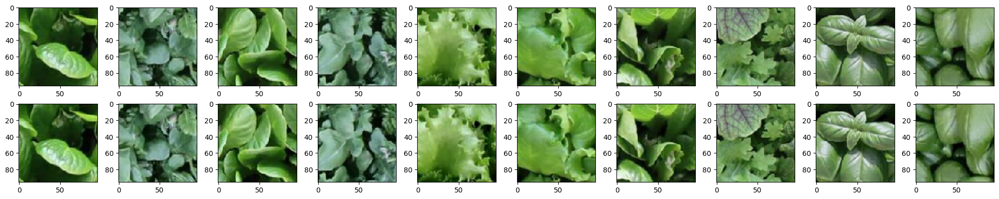

In [ ]:
contrast = tf.keras.Sequential([
    tfkl.RandomContrast(0.4),
])

num_img = 10

X_train_contrast = contrast(X_train)
X_train_contrast_np = X_train_contrast.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_contrast_np[i].astype('uint8'))
plt.tight_layout()
plt.show()



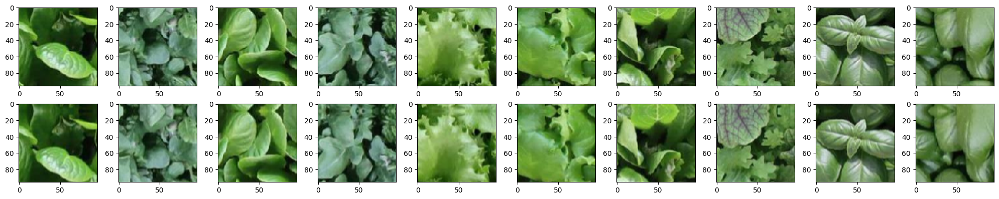

In [ ]:
translation = tf.keras.Sequential([
    tfkl.RandomTranslation(
        width_factor=(0.), #A negative value means shifting image left, while a positive value means shifting image right.
        height_factor=(0.1,0.1), #A negative value means shifting image up, while a positive value means shifting image down
    ),
])

num_img = 10

X_train_translation = translation(X_train)
X_train_translation_np = X_train_translation.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_translation_np[i].astype('uint8'))
plt.tight_layout()
plt.show()

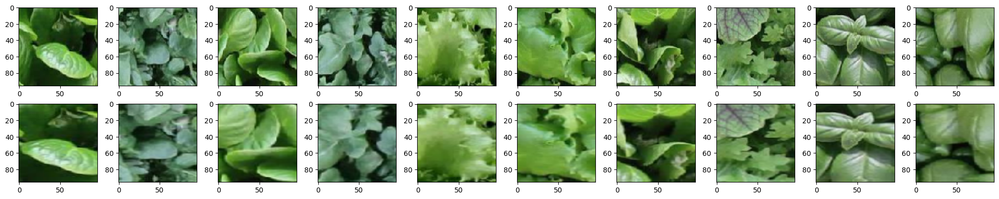

In [ ]:
zoom = tf.keras.Sequential([
    tfkl.RandomZoom(
      height_factor=(-0.1), #negative values is for zooming in, instead positive values for zooming out
      width_factor=(-0.4, -0.4)
    )
])

num_img = 10

X_train_zoom = zoom(X_train)
X_train_zoom_np = X_train_zoom.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_zoom_np[i].astype('uint8'))
plt.tight_layout()
plt.show()

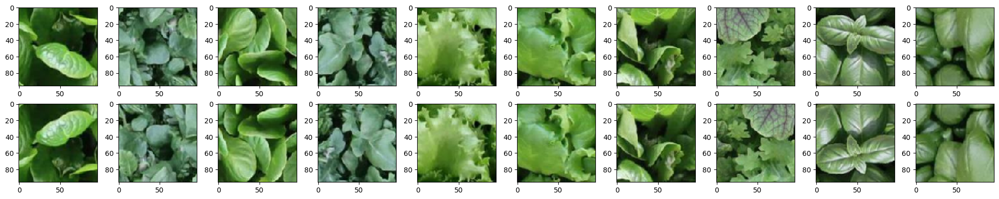

In [ ]:
flip = tf.keras.Sequential([
    tfkl.RandomFlip(mode="horizontal_and_vertical"),
])

num_img = 10

X_train_flip = flip(X_train)
X_train_flip_np = X_train_flip.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_flip_np[i].astype('uint8'))
plt.tight_layout()
plt.show()

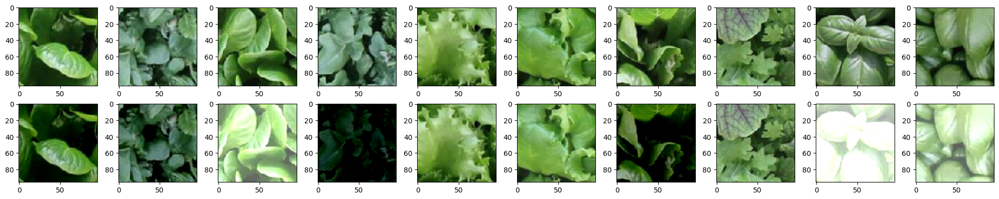

In [ ]:
brightness = tf.keras.Sequential([
        tfkl.RandomBrightness(0.7), # --> very bad result
])

num_img = 10

X_train_brightness = brightness(X_train)
X_train_brightness_np = X_train_brightness.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_brightness_np[i].astype('uint8'))
plt.tight_layout()
plt.show()

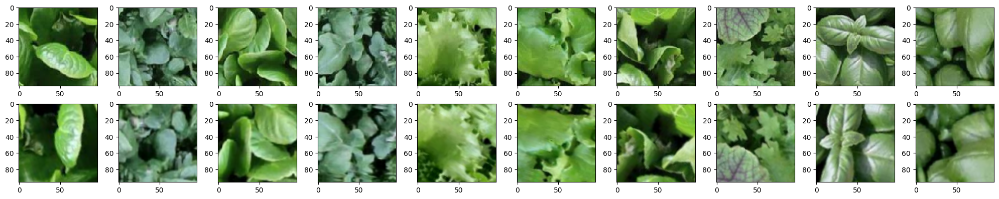

In [ ]:
rotation = tf.keras.Sequential([
          tfkl.RandomRotation(0.3),
])

num_img = 10

X_train_rotation = rotation(X_train)
X_train_rotation_np = X_train_rotation.numpy()



fig, axes = plt.subplots(2, num_img, figsize=(20,4))
for i in range(num_img):
    ax = axes[0,i%num_img]
    ax.imshow(X_train[i].astype('uint8'))
    ax = axes[1,i%num_img]
    ax.imshow(X_train_rotation_np[i].astype('uint8'))
plt.tight_layout()
plt.show()

In [ ]:
preprocessing = tf.keras.Sequential([
        tfkl.RandomContrast(0.75),
        tfkl.RandomZoom(height_factor=(-0.1),width_factor=(-0.2, -0.2)),
        tfkl.RandomFlip(mode="horizontal_and_vertical"),
        tfkl.RandomRotation(0.3),
    ], name='preprocessing')


# Xception architecture
- Instantiate a base model and load pre-trained weights into it.
- Freeze all layers in the base model by setting trainable = False.
- reate a new model on top of the output of one (or several) layers from the base model.
- Train your new model on your new dataset.

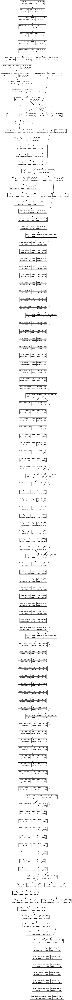

In [ ]:
Xception_model = tfk.applications.Xception(
    include_top = False,
    input_shape=input_shape,
    weights='imagenet',
    pooling='avg',
)

tfk.utils.plot_model(Xception_model, show_shapes=True)


In [ ]:
Xception_model.trainable=False


inputs = tfk.Input(input_shape)
# Connect Xception model to the input

x = Xception_model(inputs)#x = Xception_model(inputs, training=False) -->training=False?
x = tfkl.Dropout(0.3)(x)
outputs = tfkl.Dense(units=2,activation='softmax')(x)

# Create a Model connecting input and output
Xception_model = tfk.Model(inputs=inputs, outputs=outputs, name='Xception_model')

# Compile the model with Categorical Cross-Entropy loss and Adam optimizer
Xception_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])
Xception_model.summary()

Model: "Xception_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_45 (InputLayer)       [(None, 96, 96, 3)]       0         
                                                                 
 xception (Functional)       (None, 2048)              20861480  
                                                                 
 dropout_21 (Dropout)        (None, 2048)              0         
                                                                 
 dense_21 (Dense)            (None, 2)                 4098      
                                                                 
Total params: 20865578 (79.60 MB)
Trainable params: 4098 (16.01 KB)
Non-trainable params: 20861480 (79.58 MB)
_________________________________________________________________


**Transfer learning with Xception model on imagenet weights**
- 76-78% of accuracy with lr=0.001 bs=128 patience=20 only 1dl -
- 62-63% of accuracy with lr=1e-2 bs=128 patience=20
- 74-75% of accuracy with lr=1e-4 bs=128 patience=20
- 62-63% of accuracy with lr=1e-4 bs=16 patience=20


In [ ]:
callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=30, restore_best_weights=True, mode='max'),
]

# Train the model
Xception_history = Xception_model.fit(
    x = tf.keras.applications.xception.preprocess_input(augmentedX),
    y = augmentedy,
    batch_size = 32,
    epochs = 400,
    validation_data = (tf.keras.applications.xception.preprocess_input(X_val), y_val),
    callbacks = callbacks
).history

Epoch 1/400
161/161 [==============================] - 10s 48ms/step - loss: 0.5309 - accuracy: 0.7458 - val_loss: 0.7191 - val_accuracy: 0.3714
Epoch 2/400
161/161 [==============================] - 6s 36ms/step - loss: 0.4571 - accuracy: 0.7934 - val_loss: 0.7316 - val_accuracy: 0.3714
Epoch 3/400
161/161 [==============================] - 6s 37ms/step - loss: 0.4305 - accuracy: 0.8138 - val_loss: 0.7344 - val_accuracy: 0.3714
Epoch 4/400
161/161 [==============================] - 6s 36ms/step - loss: 0.4156 - accuracy: 0.8150 - val_loss: 0.7492 - val_accuracy: 0.3714
Epoch 5/400
161/161 [==============================] - 6s 36ms/step - loss: 0.4082 - accuracy: 0.8251 - val_loss: 0.7385 - val_accuracy: 0.3714
Epoch 6/400
161/161 [==============================] - 6s 35ms/step - loss: 0.3983 - accuracy: 0.8198 - val_loss: 0.7465 - val_accuracy: 0.3714
Epoch 7/400
161/161 [==============================] - 6s 35ms/step - loss: 0.3891 - accuracy: 0.8301 - val_loss: 0.7650 - val_accuracy

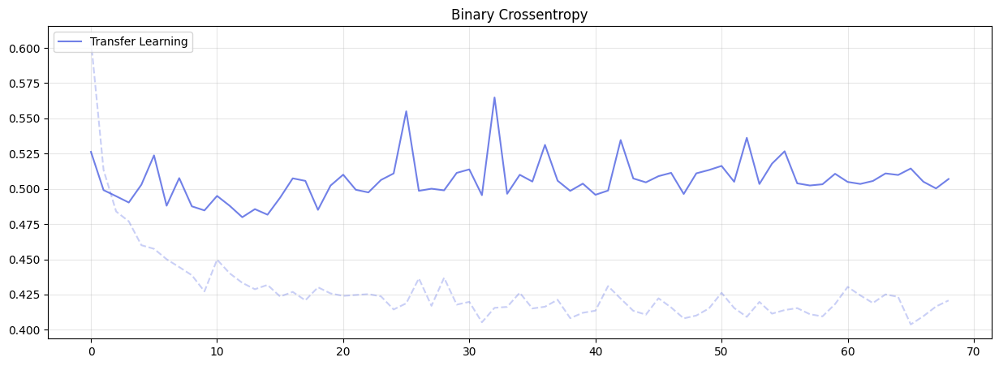

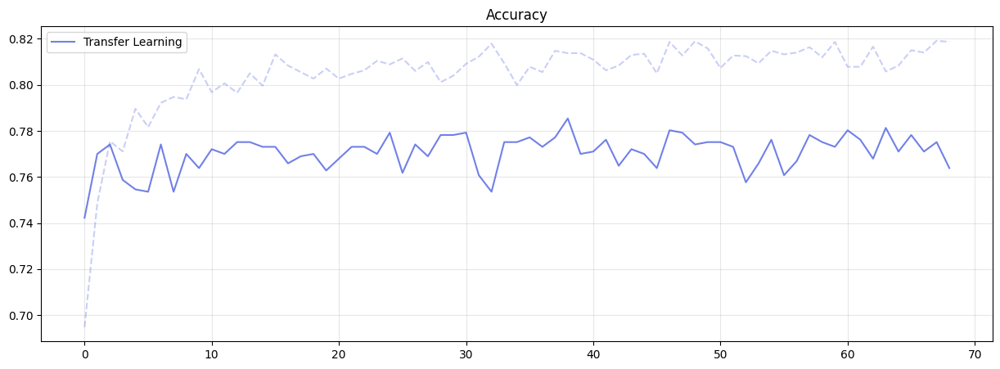

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(Xception_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(Xception_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(Xception_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(Xception_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
print(X_val)

**Fine Tuning**

Once your model has converged on the new data, you can try to unfreeze all or part of the base model and retrain the whole model end-to-end with a very low learning rate.
  - This is an optional last step that can potentially give you incremental improvements. It could also potentially lead to quick overfitting

- *It is critical to only do this step after the model with frozen layers has been trained to convergence. If you mix randomly-initialized trainable layers with trainable layers that hold pre-trained features, the randomly-initialized layers will cause very large gradient updates during training, which will destroy your pre-trained features.*

- *It's also critical to use a very low learning rate at this stage, because you are training a much larger model than in the first round of training, on a dataset that is typically very small. As a result, you are at risk of overfitting very quickly if you apply large weight updates. Here, you only want to readapt the pretrained weights in an incremental way.*


In [ ]:
Xception_model.get_layer('xception').trainable = True
# 14 24 34 124
for i, layer in enumerate(Xception_model.get_layer("xception").layers):
  print(i, layer.name, layer.trainable)

  Xception_model.get_layer('xception').layers[14].trainable = False
  Xception_model.get_layer('xception').layers[24].trainable = False
  Xception_model.get_layer('xception').layers[34].trainable = False
  Xception_model.get_layer('xception').layers[124].trainable = False



0 input_7 True
1 block1_conv1 True
2 block1_conv1_bn True
3 block1_conv1_act True
4 block1_conv2 True
5 block1_conv2_bn True
6 block1_conv2_act True
7 block2_sepconv1 True
8 block2_sepconv1_bn True
9 block2_sepconv2_act True
10 block2_sepconv2 True
11 block2_sepconv2_bn True
12 conv2d_12 True
13 block2_pool True
14 batch_normalization_12 False
15 add_36 True
16 block3_sepconv1_act True
17 block3_sepconv1 True
18 block3_sepconv1_bn True
19 block3_sepconv2_act True
20 block3_sepconv2 True
21 block3_sepconv2_bn True
22 conv2d_13 True
23 block3_pool True
24 batch_normalization_13 False
25 add_37 True
26 block4_sepconv1_act True
27 block4_sepconv1 True
28 block4_sepconv1_bn True
29 block4_sepconv2_act True
30 block4_sepconv2 True
31 block4_sepconv2_bn True
32 conv2d_14 True
33 block4_pool True
34 batch_normalization_14 False
35 add_38 True
36 block5_sepconv1_act True
37 block5_sepconv1 True
38 block5_sepconv1_bn True
39 block5_sepconv2_act True
40 block5_sepconv2 True
41 block5_sepconv2_bn 

In [ ]:
# Freeze first N layers, if N=125 add_11 = False
N = 125
for i, layer in enumerate(Xception_model.get_layer('xception').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(Xception_model.get_layer('xception').layers):
   print(i, layer.name, layer.trainable)
Xception_model.summary()

0 input_47 False
1 block1_conv1 False
2 block1_conv1_bn False
3 block1_conv1_act False
4 block1_conv2 False
5 block1_conv2_bn False
6 block1_conv2_act False
7 block2_sepconv1 False
8 block2_sepconv1_bn False
9 block2_sepconv2_act False
10 block2_sepconv2 False
11 block2_sepconv2_bn False
12 conv2d_44 False
13 block2_pool False
14 batch_normalization_44 False
15 add_132 False
16 block3_sepconv1_act False
17 block3_sepconv1 False
18 block3_sepconv1_bn False
19 block3_sepconv2_act False
20 block3_sepconv2 False
21 block3_sepconv2_bn False
22 conv2d_45 False
23 block3_pool False
24 batch_normalization_45 False
25 add_133 False
26 block4_sepconv1_act False
27 block4_sepconv1 False
28 block4_sepconv1_bn False
29 block4_sepconv2_act False
30 block4_sepconv2 False
31 block4_sepconv2_bn False
32 conv2d_46 False
33 block4_pool False
34 batch_normalization_46 False
35 add_134 False
36 block5_sepconv1_act False
37 block5_sepconv1 False
38 block5_sepconv1_bn False
39 block5_sepconv2_act False
40 bl

In [ ]:
Xception_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.AdamW(1e-4,weight_decay=1e-5), metrics='accuracy')

In [ ]:
callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=20, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]

ft_Xception_history = Xception_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 32,
    epochs = 400,
    validation_data = (X_val, y_val),

    callbacks = callbacks
).history

Epoch 1/400
122/122 [==============================] - 41s 132ms/step - loss: 0.5575 - accuracy: 0.7198 - val_loss: 0.4461 - val_accuracy: 0.8090 - lr: 1.0000e-04
Epoch 2/400
122/122 [==============================] - 13s 109ms/step - loss: 0.2778 - accuracy: 0.8800 - val_loss: 0.4701 - val_accuracy: 0.8060 - lr: 1.0000e-04
Epoch 3/400
122/122 [==============================] - 14s 111ms/step - loss: 0.1464 - accuracy: 0.9443 - val_loss: 0.4860 - val_accuracy: 0.8172 - lr: 1.0000e-04
Epoch 4/400
122/122 [==============================] - 14s 112ms/step - loss: 0.0907 - accuracy: 0.9681 - val_loss: 0.5932 - val_accuracy: 0.8296 - lr: 1.0000e-04
Epoch 5/400
122/122 [==============================] - 14s 112ms/step - loss: 0.0580 - accuracy: 0.9815 - val_loss: 0.6382 - val_accuracy: 0.8255 - lr: 1.0000e-04
Epoch 6/400
122/122 [==============================] - 14s 113ms/step - loss: 0.0519 - accuracy: 0.9861 - val_loss: 0.6624 - val_accuracy: 0.8172 - lr: 1.0000e-04
Epoch 7/400
122/122 [=

KeyboardInterrupt: ignored

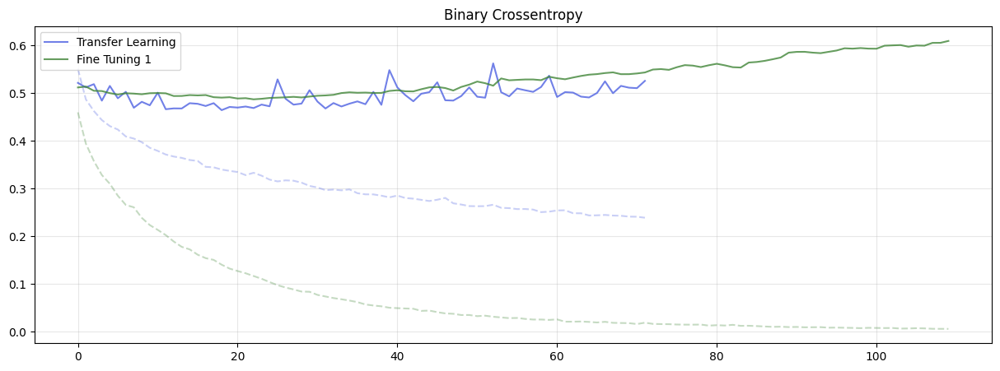

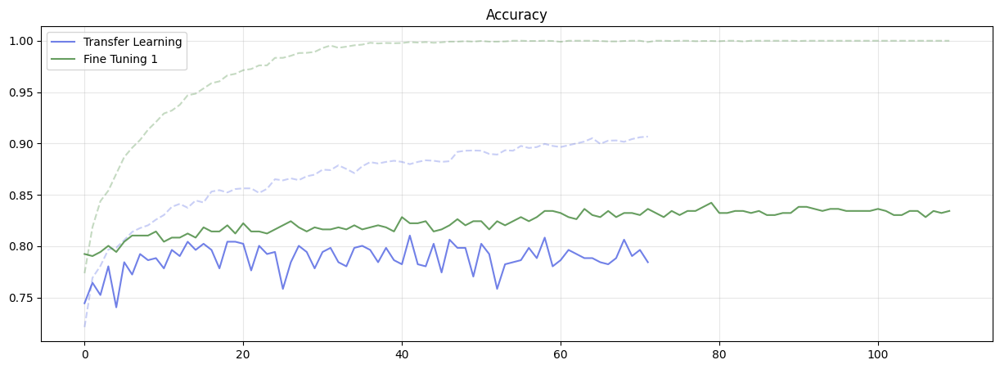

In [ ]:
# Plot the re-trained, the transfer learning and the fine-tuned MobileNetV2 training histories
plt.figure(figsize=(15,5))
plt.plot(Xception_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(Xception_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(ft_Xception_history['loss'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft_Xception_history['val_loss'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))

plt.plot(Xception_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(Xception_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(ft_Xception_history['accuracy'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft_Xception_history['val_accuracy'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
Xception_model.get_layer('xception').trainable = True

N = 116
M = 126
for i, layer in enumerate(Xception_model.get_layer('xception').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(Xception_model.get_layer('xception').layers[M:]):
  layer.trainable=False
for i, layer in enumerate(Xception_model.get_layer('xception').layers):
   print(i, layer.name, layer.trainable)
Xception_model.summary()

0 input_23 False
1 block1_conv1 False
2 block1_conv1_bn False
3 block1_conv1_act False
4 block1_conv2 False
5 block1_conv2_bn False
6 block1_conv2_act False
7 block2_sepconv1 False
8 block2_sepconv1_bn False
9 block2_sepconv2_act False
10 block2_sepconv2 False
11 block2_sepconv2_bn False
12 conv2d False
13 block2_pool False
14 batch_normalization False
15 add False
16 block3_sepconv1_act False
17 block3_sepconv1 False
18 block3_sepconv1_bn False
19 block3_sepconv2_act False
20 block3_sepconv2 False
21 block3_sepconv2_bn False
22 conv2d_1 False
23 block3_pool False
24 batch_normalization_1 False
25 add_1 False
26 block4_sepconv1_act False
27 block4_sepconv1 False
28 block4_sepconv1_bn False
29 block4_sepconv2_act False
30 block4_sepconv2 False
31 block4_sepconv2_bn False
32 conv2d_2 False
33 block4_pool False
34 batch_normalization_2 False
35 add_2 False
36 block5_sepconv1_act False
37 block5_sepconv1 False
38 block5_sepconv1_bn False
39 block5_sepconv2_act False
40 block5_sepconv2 Fals

In [ ]:
Xception_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(1e-5), metrics='accuracy')

In [ ]:
ft2_Xception_history = Xception_model.fit(
    #x = preprocess_input(X_train*255), # We need to apply the preprocessing thought for the MobileNetV2 network
    x = tf.keras.applications.xception.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 64,
    epochs = 200,
    validation_data = (tf.keras.applications.xception.preprocess_input(X_val*255), y_val), # We need to apply the preprocessing thought for the MobileNetV2 network
    #validation_data = (X_val, y_val),
    callbacks = [tfk.callbacks.EarlyStopping(monitor='val_accuracy', mode='max', patience=15, restore_best_weights=True)]
).history

Epoch 1/200
71/71 [==============================] - 8s 48ms/step - loss: 0.5406 - accuracy: 0.7324 - val_loss: 0.6079 - val_accuracy: 0.7804
Epoch 2/200
71/71 [==============================] - 2s 27ms/step - loss: 0.4495 - accuracy: 0.7846 - val_loss: 0.6638 - val_accuracy: 0.7485
Epoch 3/200
71/71 [==============================] - 2s 27ms/step - loss: 0.3962 - accuracy: 0.8139 - val_loss: 0.6693 - val_accuracy: 0.7206
Epoch 4/200
71/71 [==============================] - 2s 27ms/step - loss: 0.3652 - accuracy: 0.8337 - val_loss: 0.6528 - val_accuracy: 0.7265
Epoch 5/200
71/71 [==============================] - 2s 27ms/step - loss: 0.3321 - accuracy: 0.8488 - val_loss: 0.6289 - val_accuracy: 0.7425
Epoch 6/200
71/71 [==============================] - 2s 27ms/step - loss: 0.2975 - accuracy: 0.8705 - val_loss: 0.6082 - val_accuracy: 0.7485
Epoch 7/200
71/71 [==============================] - 2s 27ms/step - loss: 0.2720 - accuracy: 0.8847 - val_loss: 0.5979 - val_accuracy: 0.7545
Epoch 

In [ ]:
Xception_model.get_layer('xception').trainable = True

N = 116
for i, layer in enumerate(Xception_model.get_layer('xception').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(Xception_model.get_layer('xception').layers):
   print(i, layer.name, layer.trainable)
Xception_model.summary()

0 input_3 False
1 block1_conv1 False
2 block1_conv1_bn False
3 block1_conv1_act False
4 block1_conv2 False
5 block1_conv2_bn False
6 block1_conv2_act False
7 block2_sepconv1 False
8 block2_sepconv1_bn False
9 block2_sepconv2_act False
10 block2_sepconv2 False
11 block2_sepconv2_bn False
12 conv2d_4 False
13 block2_pool False
14 batch_normalization_4 False
15 add_12 False
16 block3_sepconv1_act False
17 block3_sepconv1 False
18 block3_sepconv1_bn False
19 block3_sepconv2_act False
20 block3_sepconv2 False
21 block3_sepconv2_bn False
22 conv2d_5 False
23 block3_pool False
24 batch_normalization_5 False
25 add_13 False
26 block4_sepconv1_act False
27 block4_sepconv1 False
28 block4_sepconv1_bn False
29 block4_sepconv2_act False
30 block4_sepconv2 False
31 block4_sepconv2_bn False
32 conv2d_6 False
33 block4_pool False
34 batch_normalization_6 False
35 add_14 False
36 block5_sepconv1_act False
37 block5_sepconv1 False
38 block5_sepconv1_bn False
39 block5_sepconv2_act False
40 block5_sepco

In [ ]:
Xception_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(1e-5), metrics='accuracy')

In [ ]:
ft3_Xception_history = Xception_model.fit(
    #x = preprocess_input(X_train*255), # We need to apply the preprocessing thought for the MobileNetV2 network
    x = tf.keras.applications.xception.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 16,
    epochs = 200,
    validation_data = (tf.keras.applications.xception.preprocess_input(X_val*255), y_val), # We need to apply the preprocessing thought for the MobileNetV2 network
    #validation_data = (X_val, y_val),
    callbacks = [tfk.callbacks.EarlyStopping(monitor='val_accuracy', mode='max', patience=10, restore_best_weights=True)]
).history

Epoch 1/200
282/282 [==============================] - 10s 18ms/step - loss: 0.5855 - accuracy: 0.6949 - val_loss: 0.5069 - val_accuracy: 0.7645
Epoch 2/200
282/282 [==============================] - 4s 14ms/step - loss: 0.4892 - accuracy: 0.7930 - val_loss: 0.4839 - val_accuracy: 0.7884
Epoch 3/200
282/282 [==============================] - 4s 14ms/step - loss: 0.4353 - accuracy: 0.8139 - val_loss: 0.4572 - val_accuracy: 0.8124
Epoch 4/200
282/282 [==============================] - 4s 14ms/step - loss: 0.3942 - accuracy: 0.8432 - val_loss: 0.4330 - val_accuracy: 0.8224
Epoch 5/200
282/282 [==============================] - 4s 14ms/step - loss: 0.3627 - accuracy: 0.8539 - val_loss: 0.4272 - val_accuracy: 0.8184
Epoch 6/200
282/282 [==============================] - 4s 14ms/step - loss: 0.3305 - accuracy: 0.8665 - val_loss: 0.4200 - val_accuracy: 0.8144
Epoch 7/200
282/282 [==============================] - 4s 14ms/step - loss: 0.2998 - accuracy: 0.8792 - val_loss: 0.4131 - val_accuracy

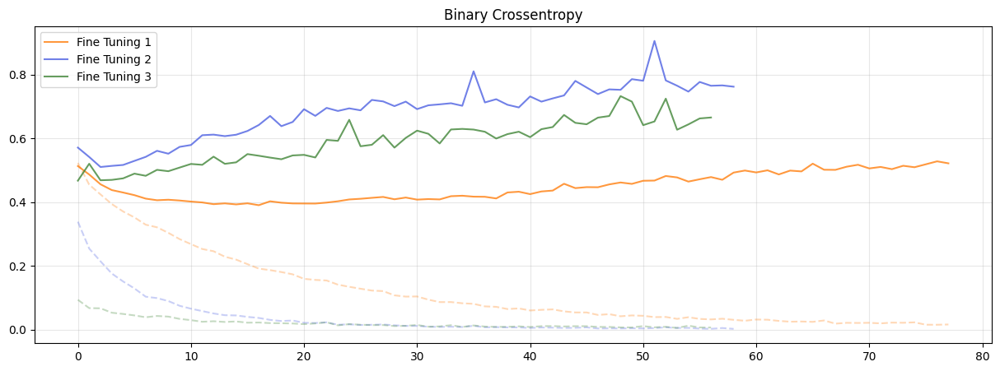

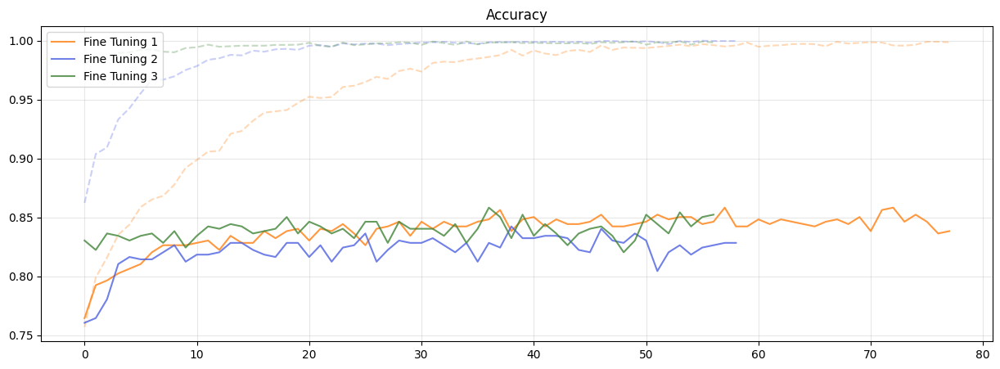

In [ ]:
# Plot the re-trained, the transfer learning and the fine-tuned MobileNetV2 training histories
plt.figure(figsize=(15,5))
plt.plot(ft_Xception_history['loss'], alpha=.3, color='#ff7f0e', linestyle='--')
plt.plot(ft_Xception_history['val_loss'], label='Fine Tuning 1', alpha=.8, color='#ff7f0e')
plt.plot(ft2_Xception_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(ft2_Xception_history['val_loss'], label='Fine Tuning 2', alpha=.8, color='#4D61E2')
plt.plot(ft3_Xception_history['loss'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft3_Xception_history['val_loss'], label='Fine Tuning 3', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(ft_Xception_history['accuracy'], alpha=.3, color='#ff7f0e', linestyle='--')
plt.plot(ft_Xception_history['val_accuracy'], label='Fine Tuning 1', alpha=.8, color='#ff7f0e')
plt.plot(ft2_Xception_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(ft2_Xception_history['val_accuracy'], label='Fine Tuning 2', alpha=.8, color='#4D61E2')
plt.plot(ft3_Xception_history['accuracy'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft3_Xception_history['val_accuracy'], label='Fine Tuning 3', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

# quasiVGG9 model (from classes)
 - 0.6188 of accuracy on val_set

In [ ]:
def build_quasiVGG9(input_shape, output_shape, seed=seed):
    tf.random.set_seed(seed)

    # Build the neural network layer by layer
    input_layer = tfkl.Input(shape=input_shape, name='Input')

    x = tfkl.Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',name='conv00')(input_layer)
    x = tfkl.Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',name='conv01')(x)
    x = tfkl.MaxPooling2D(name='mp0')(x)

    x = tfkl.Conv2D(filters=64,kernel_size=3,padding='same',activation='relu',name='conv10')(x)
    x = tfkl.Conv2D(filters=64,kernel_size=3,padding='same',activation='relu',name='conv11')(x)
    x = tfkl.MaxPooling2D(name='mp1')(x)

    x = tfkl.Conv2D(filters=128,kernel_size=3,padding='same',activation='relu',name='conv20')(x)
    x = tfkl.Conv2D(filters=128,kernel_size=3,padding='same',activation='relu',name='conv21')(x)
    x = tfkl.MaxPooling2D(name='mp2')(x)

    x = tfkl.Conv2D(filters=256,kernel_size=3,padding='same',activation='relu',name='conv30')(x)
    x = tfkl.Conv2D(filters=256,kernel_size=3,padding='same',activation='relu',name='conv31')(x)
    x = tfkl.GlobalAveragePooling2D(name='gap')(x)

    output_layer = tfkl.Dense(units=output_shape,activation='softmax',name='Output')(x)

    # Connect input and output through the Model class
    model = tfk.Model(inputs=input_layer, outputs=output_layer, name='Convnet')

    # Compile the model
    model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(weight_decay=5e-4), metrics=['accuracy'])

    # Return the model
    return model

model = build_quasiVGG9(input_shape, output_shape)
model.summary()
modelname = "deiv_baseline_quasiVGG9"

Model: "Convnet"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Input (InputLayer)          [(None, 96, 96, 3)]       0         
                                                                 
 conv00 (Conv2D)             (None, 96, 96, 32)        896       
                                                                 
 conv01 (Conv2D)             (None, 96, 96, 32)        9248      
                                                                 
 mp0 (MaxPooling2D)          (None, 48, 48, 32)        0         
                                                                 
 conv10 (Conv2D)             (None, 48, 48, 64)        18496     
                                                                 
 conv11 (Conv2D)             (None, 48, 48, 64)        36928     
                                                                 
 mp1 (MaxPooling2D)          (None, 24, 24, 64)        0   

In [ ]:
early_stopping = tfk.callbacks.EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)

# Train the model and save its history
history = model.fit(
    x=X_train,
    y=y_train,
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(X_val, y_val),
    callbacks=[early_stopping]
).history

# Save the trained model
#model.save('QuasiVGG9_CIFAR10')

Epoch 1/20
141/141 [==============================] - 7s 31ms/step - loss: 0.6680 - accuracy: 0.3802 - val_loss: 0.6646 - val_accuracy: 0.3812
Epoch 2/20
141/141 [==============================] - 4s 29ms/step - loss: 0.6652 - accuracy: 0.3802 - val_loss: 0.6645 - val_accuracy: 0.3812
Epoch 3/20
141/141 [==============================] - 4s 27ms/step - loss: 0.6653 - accuracy: 0.3802 - val_loss: 0.6645 - val_accuracy: 0.3812
Epoch 4/20
141/141 [==============================] - 4s 27ms/step - loss: 0.6661 - accuracy: 0.3802 - val_loss: 0.6652 - val_accuracy: 0.3812
Epoch 5/20
141/141 [==============================] - 4s 28ms/step - loss: 0.6625 - accuracy: 0.3802 - val_loss: 0.6459 - val_accuracy: 0.3812
Epoch 6/20
141/141 [==============================] - 4s 28ms/step - loss: 0.6296 - accuracy: 0.3802 - val_loss: 0.6681 - val_accuracy: 0.3812


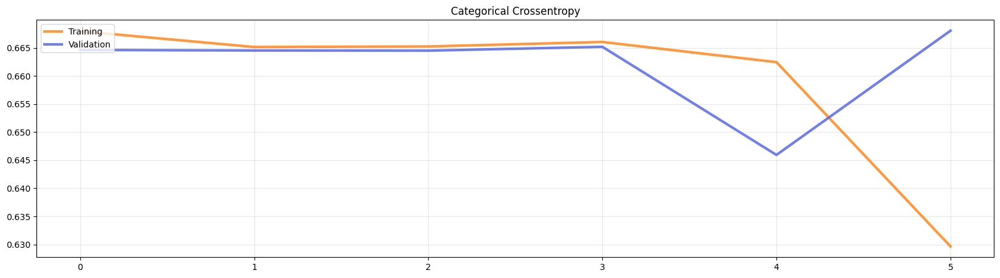

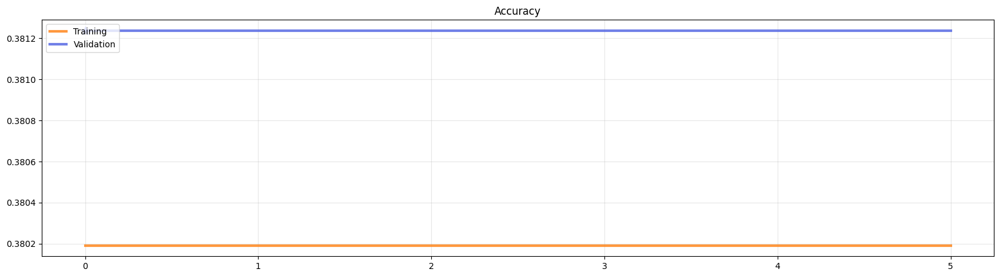

In [ ]:
best_epoch = np.argmax(history['val_accuracy'])

# Plot training and validation performance metrics
plt.figure(figsize=(20, 5))

# Plot training and validation loss
plt.plot(history['loss'], label='Training', alpha=0.8, color='#ff7f0e', linewidth=3)
plt.plot(history['val_loss'], label='Validation', alpha=0.8, color='#4D61E2', linewidth=3)
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=0.3)

plt.figure(figsize=(20, 5))

# Plot training and validation accuracy, highlighting the best epoch
plt.plot(history['accuracy'], label='Training', alpha=0.8, color='#ff7f0e', linewidth=3)
plt.plot(history['val_accuracy'], label='Validation', alpha=0.8, color='#4D61E2', linewidth=3)
plt.plot(best_epoch, history['val_accuracy'][best_epoch], marker='*', alpha=0.8, markersize=10, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=0.3)

plt.show()

# Baseline model

In [ ]:
#model section
def build_model(input_shape=input_shape, output_shape=output_shape):
  input = tfk.layers.Input(input_shape)

  conv1 = tfkl.Conv2D(
      filters= 32,
      kernel_size = (7,7),
      padding = 'valid',
      activation='relu',
      name = "conv1"
      )(input)
  pool1 = tfkl.MaxPool2D(
      pool_size = (2,2),
      name = "p1"
      )(conv1)

  conv2 = tfkl.Conv2D(
      filters= 64,
      kernel_size = (5,5),
      padding = 'valid',
      activation='relu',
      name = "conv2"
      )(pool1)
  pool2 = tfkl.MaxPool2D(
      pool_size = (2,2),
      name = "p2"
      )(conv2)

  conv3 = tfkl.Conv2D(
      filters= 128,
      kernel_size = (3,3),
      padding = 'valid',
      activation='relu',
      name = "conv3"
      )(pool2)
  pool3 = tfkl.MaxPool2D( #last avg pooling
      pool_size = (2,2),
      name = "p3"
      )(conv3)

  conv4 = tfkl.Conv2D(
      filters= 264,
      kernel_size = (3,3),
      padding = 'valid',
      activation='relu',
      name = "conv4"
      )(pool3)
  pool4 = tfkl.MaxPool2D( #last avg pooling
      pool_size = (2,2),
      name = "p4"
      )(conv4)


  flattering_layer =tfkl.Flatten(
      name="flatten"
  )(pool4)


  dense1 = tfk.layers.Dense(128, activation='relu')(flattering_layer)
  dense2 = tfk.layers.Dense(128, activation='relu')(dense1)
  dense3 = tfk.layers.Dense(64, activation='relu')(dense2)


  output = tfk.layers.Dense(
      units = output_shape,
      activation=tfk.activations.sigmoid,
      name="output"
      )(dense2)

  # Connect input and output through the Model class
  model = tfk.Model(inputs=input, outputs=output)
  # Compile the model
  model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])

  # Return the model
  return model

model = build_model()
model.summary()
tfk.utils.plot_model(model, expand_nested=True, show_shapes=True)
modelname = "deiv_baseline"

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_20 (InputLayer)       [(None, 96, 96, 3)]       0         
                                                                 
 conv1 (Conv2D)              (None, 90, 90, 32)        4736      
                                                                 
 p1 (MaxPooling2D)           (None, 45, 45, 32)        0         
                                                                 
 conv2 (Conv2D)              (None, 41, 41, 64)        51264     
                                                                 
 p2 (MaxPooling2D)           (None, 20, 20, 64)        0         
                                                                 
 conv3 (Conv2D)              (None, 18, 18, 128)       73856     
                                                                 
 p3 (MaxPooling2D)           (None, 9, 9, 128)         0   

In [ ]:
#callbacks = [
#    keras.callbacks.EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, mode='auto'),
#]
early_stopping = tfk.callbacks.EarlyStopping(monitor='val_accuracy', patience=5, mode='max', restore_best_weights=True)


# Train the model
history = model.fit(
    x = X_train,
    y = y_train,
    batch_size = batch_size,
    epochs = epochs,
    validation_data = (X_val, y_val),
    callbacks = [early_stopping]
).history

Epoch 1/20
141/141 [==============================] - 7s 21ms/step - loss: 0.6682 - accuracy: 0.6196 - val_loss: 0.6639 - val_accuracy: 0.6188
Epoch 2/20
141/141 [==============================] - 2s 15ms/step - loss: 0.6675 - accuracy: 0.6198 - val_loss: 0.6686 - val_accuracy: 0.6188
Epoch 3/20
141/141 [==============================] - 2s 15ms/step - loss: 0.6652 - accuracy: 0.6198 - val_loss: 0.6647 - val_accuracy: 0.6188
Epoch 4/20
141/141 [==============================] - 2s 14ms/step - loss: 0.6647 - accuracy: 0.6198 - val_loss: 0.6650 - val_accuracy: 0.6188
Epoch 5/20
141/141 [==============================] - 2s 14ms/step - loss: 0.6646 - accuracy: 0.6198 - val_loss: 0.6647 - val_accuracy: 0.6188
Epoch 6/20
141/141 [==============================] - 2s 16ms/step - loss: 0.6646 - accuracy: 0.6198 - val_loss: 0.6650 - val_accuracy: 0.6188


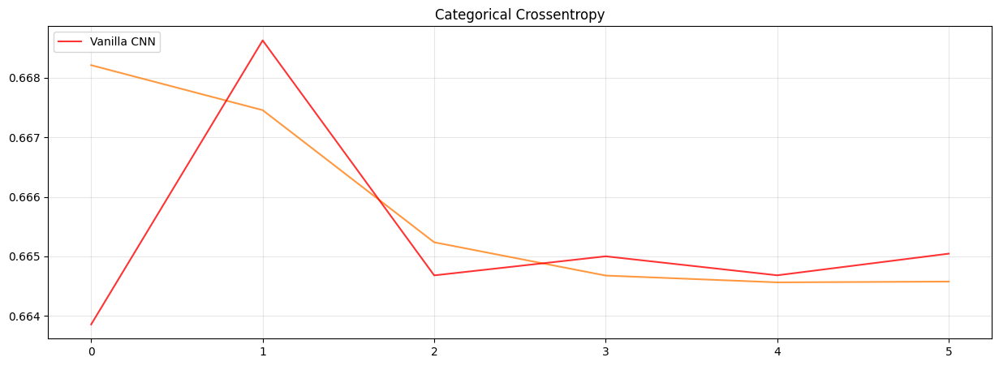

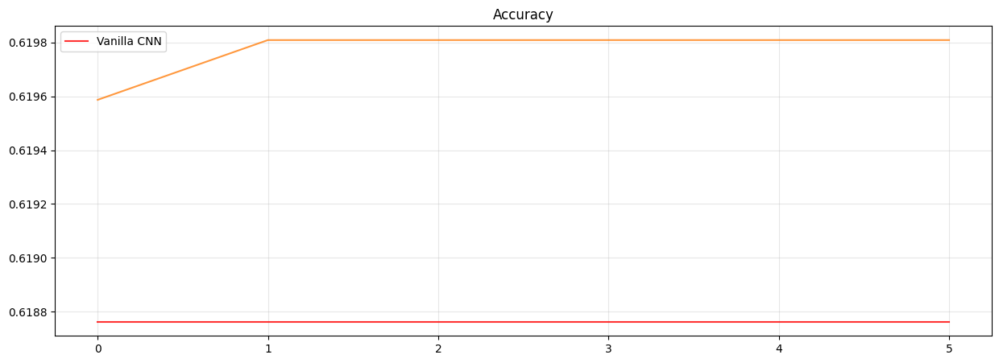

In [ ]:
# Plot the training
plt.figure(figsize=(15,5))
plt.plot(history['loss'], alpha=.8, color='#ff7f0e',)
plt.plot(history['val_loss'], label='Vanilla CNN', alpha=.8, color='#ff0000')
plt.legend(loc='upper left')
plt.title('Categorical Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(history['accuracy'], alpha=.8, color='#ff7f0e')
plt.plot(history['val_accuracy'], label='Vanilla CNN', alpha=.8, color='#ff0000')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)
plt.savefig('Models//' + modelname)

plt.show()

-prima prova di modello estremamente semplice, overfitta molto e visto che il dataset normale ha uno split 38% - 62% (unhealty - healty) nel val set il modello performa un 5,6 % meglio di un randomclassifer

-secondo modello ha blocchi di 2 conv2d consecutivi con gli stessi filtri separati da maxPool: risultati simili

-terzo modello struttura del secondo ma con il doppio dei filtri per ogni layer: il modello non migliora minimamente nelle 25 epoch e ottiene una performance in linea con randomclassifier

-quarto modello resetto il numero di filtri a quello del modello 2 ed estendo con un'altro blocco di convolution: stesso problema di prima, probabilmente ha a che fare con il numero di parametri o con la disparitá fra parametri del convolutional e quelli del dense

-quinto modello cambio il numero dei neuroni nel dense, aumentandoli:

In [ ]:
model.save('Models//' + modelname)

# Transfer learning + fine tuning


# MobileNetV2 full learned
- overfitted with 0.4511 of accuracy on val_set

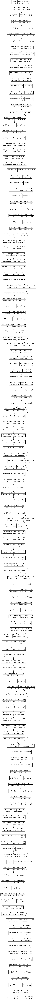

In [ ]:
# Create MobileNetV2 model with specified settings
mobile = tfk.applications.MobileNetV2(
    input_shape=(96, 96, 3),
    include_top=False,
    weights=None,
    pooling='avg',
)

# Display the model architecture with input shapes
tfk.utils.plot_model(mobile, show_shapes=True)


In [ ]:
# Create an input layer with shape (96, 96, 3)
inputs = tfk.Input(shape=(96, 96, 3))
# Connect MobileNetV2 to the input
x = mobile(inputs)
# Add a Dense layer with 2 units and softmax activation as the classifier
dropout_top = tfkl.Dropout(0.4)(x)

outputs = tfkl.Dense(1, activation=tfk.activations.sigmoid)(dropout_top)



# Create a Model connecting input and output
model = tfk.Model(inputs=inputs, outputs=outputs, name='model')

# Compile the model with Categorical Cross-Entropy loss and Adam optimizer
model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])

# Display model summary
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_22 (InputLayer)       [(None, 96, 96, 3)]       0         
                                                                 
 mobilenetv2_1.00_96 (Funct  (None, 1280)              2257984   
 ional)                                                          
                                                                 
 dense_18 (Dense)            (None, 1)                 1281      
                                                                 
Total params: 2259265 (8.62 MB)
Trainable params: 2225153 (8.49 MB)
Non-trainable params: 34112 (133.25 KB)
_________________________________________________________________


In [ ]:
# Train the model
history = model.fit(
    x = preprocess_input(X_train*255), # We need to apply the preprocessing thought for the MobileNetV2 network
    y = y_train,
    batch_size = 16,
    epochs = 200,
    validation_data = (preprocess_input(X_val*255), y_val), # We need to apply the preprocessing thought for the MobileNetV2 network
    callbacks = [tfk.callbacks.EarlyStopping(monitor='val_accuracy', mode='max', patience=20, restore_best_weights=True)]
).history

Epoch 1/200
282/282 [==============================] - 32s 41ms/step - loss: 0.6884 - accuracy: 0.6218 - val_loss: 0.7310 - val_accuracy: 0.3812
Epoch 2/200
282/282 [==============================] - 10s 34ms/step - loss: 0.5979 - accuracy: 0.6940 - val_loss: 0.7150 - val_accuracy: 0.3812
Epoch 3/200
282/282 [==============================] - 9s 32ms/step - loss: 0.5427 - accuracy: 0.7404 - val_loss: 0.7445 - val_accuracy: 0.3812
Epoch 4/200
282/282 [==============================] - 13s 45ms/step - loss: 0.5286 - accuracy: 0.7462 - val_loss: 0.7391 - val_accuracy: 0.3812
Epoch 5/200
282/282 [==============================] - 10s 36ms/step - loss: 0.5052 - accuracy: 0.7659 - val_loss: 0.7279 - val_accuracy: 0.3812
Epoch 6/200
282/282 [==============================] - 10s 35ms/step - loss: 0.4927 - accuracy: 0.7673 - val_loss: 0.7324 - val_accuracy: 0.3812
Epoch 7/200
282/282 [==============================] - 9s 31ms/step - loss: 0.4745 - accuracy: 0.7739 - val_loss: 0.7162 - val_accu

# MobileNetV2 with weights


9406464/9406464 [==============================] - 2s 0us/step


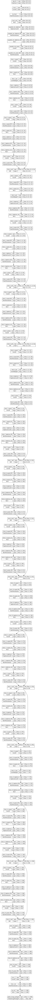

In [ ]:
mobile = tfk.applications.MobileNetV2(
    input_shape=(96,96,3),
    include_top = False,
    weights='imagenet',
    pooling='avg'
)

tfk.utils.plot_model(mobile, show_shapes=True)

In [ ]:
# Use the supernet as feature extractor, i.e. freeze all its weigths
mobile.trainable = False

# Create an input layer with shape (96, 96, 3)
inputs = tfk.Input(shape=(96, 96, 3))
# Connect MobileNetV2 to the input
x = mobile(inputs)
# Add a Dense layer with 2 units and softmax activation as the classifier
outputs = tfkl.Dense(
    units=1,
    activation=tfk.activations.sigmoid
    )(x)

# Create a Model connecting input and output
tl_model = tfk.Model(inputs=inputs, outputs=outputs, name='model')

# Compile the model with Categorical Cross-Entropy loss and Adam optimizer
tl_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])

# Display model summary
tl_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_24 (InputLayer)       [(None, 96, 96, 3)]       0         
                                                                 
 mobilenetv2_1.00_96 (Funct  (None, 1280)              2257984   
 ional)                                                          
                                                                 
 dense_19 (Dense)            (None, 1)                 1281      
                                                                 
Total params: 2259265 (8.62 MB)
Trainable params: 1281 (5.00 KB)
Non-trainable params: 2257984 (8.61 MB)
_________________________________________________________________


In [ ]:
# Train the model
tl_history = tl_model.fit(
    x = preprocess_input(X_train*255), # We need to apply the preprocessing thought for the MobileNetV2 network
    y = y_train,
    batch_size = 16,
    epochs = 200,
    validation_data = (preprocess_input(X_val*255), y_val), # We need to apply the preprocessing thought for the MobileNetV2 network
    callbacks = [tfk.callbacks.EarlyStopping(monitor='val_accuracy', mode='max', patience=20, restore_best_weights=True)]
).history

Epoch 1/200
282/282 [==============================] - 7s 15ms/step - loss: 0.5312 - accuracy: 0.7333 - val_loss: 0.4516 - val_accuracy: 0.7944
Epoch 2/200
282/282 [==============================] - 3s 11ms/step - loss: 0.4192 - accuracy: 0.8083 - val_loss: 0.4326 - val_accuracy: 0.8184
Epoch 3/200
282/282 [==============================] - 4s 13ms/step - loss: 0.3885 - accuracy: 0.8228 - val_loss: 0.4275 - val_accuracy: 0.8084
Epoch 4/200
282/282 [==============================] - 3s 11ms/step - loss: 0.3683 - accuracy: 0.8428 - val_loss: 0.4130 - val_accuracy: 0.8164
Epoch 5/200
282/282 [==============================] - 3s 10ms/step - loss: 0.3507 - accuracy: 0.8494 - val_loss: 0.4102 - val_accuracy: 0.8144
Epoch 6/200
282/282 [==============================] - 3s 10ms/step - loss: 0.3415 - accuracy: 0.8579 - val_loss: 0.4072 - val_accuracy: 0.8224
Epoch 7/200
282/282 [==============================] - 4s 13ms/step - loss: 0.3304 - accuracy: 0.8583 - val_loss: 0.4095 - val_accuracy:

# ResNet50V2

94668760/94668760 [==============================] - 4s 0us/step


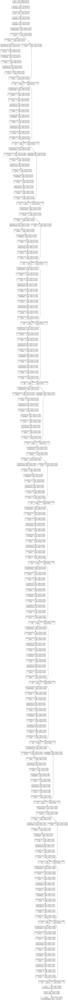

In [ ]:
from keras.src.applications import ResNet50V2
ResNet50V2_model = ResNet50V2(
    include_top = False,
    weights = "imagenet",
    input_shape = input_shape,
    pooling = "avg"
)

tfk.utils.plot_model(ResNet50V2_model, show_shapes=True)

In [ ]:
ResNet50V2_model.trainable=False
inputs = tfk.Input(input_shape)
# Connect ResNet50V2 model to the input
x = ResNet50V2_model(inputs)
#dense = tfkl.Dense(256,activation='relu')(x)
#dropout = tfkl.Dropout(0.4)(dense)
outputs = tfkl.Dense(
    units=1,
    activation=tfk.activations.sigmoid
    )(x)

# Create a Model connecting input and output
ResNet50V2_model = tfk.Model(inputs=inputs, outputs=outputs, name='ResNet50V2_model')

# Compile the model with Categorical Cross-Entropy loss and Adam optimizer
ResNet50V2_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.Adam(), metrics=['accuracy'])
ResNet50V2_model.summary()

Model: "ResNet50V2_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 96, 96, 3)]       0         
                                                                 
 resnet50v2 (Functional)     (None, 2048)              23564800  
                                                                 
 dense (Dense)               (None, 1)                 2049      
                                                                 
Total params: 23566849 (89.90 MB)
Trainable params: 2049 (8.00 KB)
Non-trainable params: 23564800 (89.89 MB)
_________________________________________________________________


In [ ]:


# Train the model
tl_ResNet50V2_history = ResNet50V2_model.fit(
    x = tf.keras.applications.resnet_v2.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 16,
    epochs = 150,
    validation_data = (tf.keras.applications.resnet_v2.preprocess_input(X_val*255), y_val), #
    callbacks = [tfk.callbacks.EarlyStopping(monitor='val_accuracy', mode='max', patience=20, restore_best_weights=True)]
).history

Epoch 1/150
282/282 [==============================] - 16s 18ms/step - loss: 0.5593 - accuracy: 0.7328 - val_loss: 0.5133 - val_accuracy: 0.7525
Epoch 2/150
282/282 [==============================] - 3s 12ms/step - loss: 0.4507 - accuracy: 0.7824 - val_loss: 0.4948 - val_accuracy: 0.7685
Epoch 3/150
282/282 [==============================] - 3s 12ms/step - loss: 0.4114 - accuracy: 0.8061 - val_loss: 0.5128 - val_accuracy: 0.7784
Epoch 4/150
282/282 [==============================] - 3s 12ms/step - loss: 0.3857 - accuracy: 0.8226 - val_loss: 0.4940 - val_accuracy: 0.7844
Epoch 5/150
282/282 [==============================] - 3s 11ms/step - loss: 0.3689 - accuracy: 0.8337 - val_loss: 0.5156 - val_accuracy: 0.7725
Epoch 6/150
282/282 [==============================] - 3s 12ms/step - loss: 0.3532 - accuracy: 0.8399 - val_loss: 0.5038 - val_accuracy: 0.7884
Epoch 7/150
282/282 [==============================] - 3s 12ms/step - loss: 0.3399 - accuracy: 0.8485 - val_loss: 0.4951 - val_accuracy

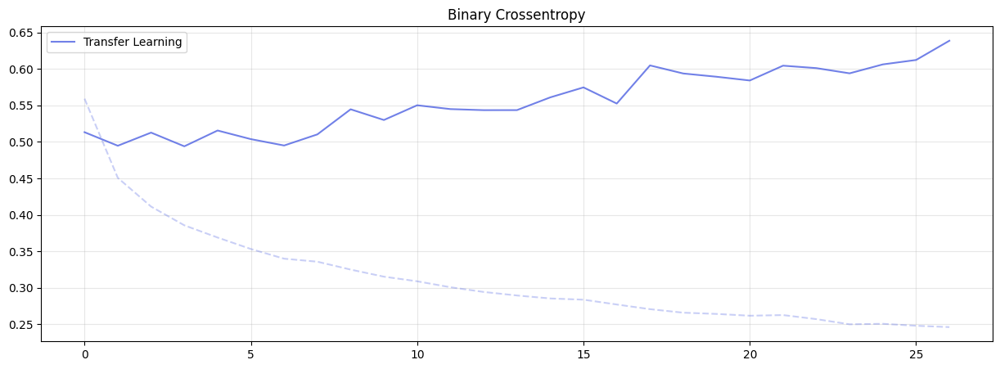

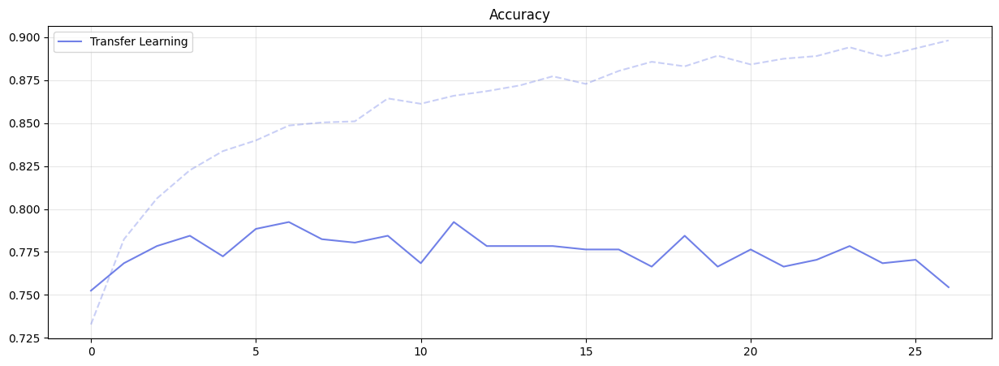

In [ ]:
# Plot the re-trained, the transfer learning and the fine-tuned MobileNetV2 training histories
plt.figure(figsize=(15,5))
plt.plot(tl_ResNet50V2_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(tl_ResNet50V2_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))

plt.plot(tl_ResNet50V2_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(tl_ResNet50V2_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
ResNet50V2_model.get_layer('resnet50v2').trainable = True

for i, layer in enumerate(ResNet50V2_model.get_layer("resnet50v2").layers):
  print(i, layer.name, layer.trainable)

0 input_1 True
1 conv1_pad True
2 conv1_conv True
3 pool1_pad True
4 pool1_pool True
5 conv2_block1_preact_bn True
6 conv2_block1_preact_relu True
7 conv2_block1_1_conv True
8 conv2_block1_1_bn True
9 conv2_block1_1_relu True
10 conv2_block1_2_pad True
11 conv2_block1_2_conv True
12 conv2_block1_2_bn True
13 conv2_block1_2_relu True
14 conv2_block1_0_conv True
15 conv2_block1_3_conv True
16 conv2_block1_out True
17 conv2_block2_preact_bn True
18 conv2_block2_preact_relu True
19 conv2_block2_1_conv True
20 conv2_block2_1_bn True
21 conv2_block2_1_relu True
22 conv2_block2_2_pad True
23 conv2_block2_2_conv True
24 conv2_block2_2_bn True
25 conv2_block2_2_relu True
26 conv2_block2_3_conv True
27 conv2_block2_out True
28 conv2_block3_preact_bn True
29 conv2_block3_preact_relu True
30 conv2_block3_1_conv True
31 conv2_block3_1_bn True
32 conv2_block3_1_relu True
33 conv2_block3_2_pad True
34 conv2_block3_2_conv True
35 conv2_block3_2_bn True
36 conv2_block3_2_relu True
37 max_pooling2d True

In [ ]:
# Freeze first N layers
N = 154
for i, layer in enumerate(ResNet50V2_model.get_layer('resnet50v2').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(ResNet50V2_model.get_layer('resnet50v2').layers):
   print(i, layer.name, layer.trainable)
ResNet50V2_model.summary()

0 input_1 False
1 conv1_pad False
2 conv1_conv False
3 pool1_pad False
4 pool1_pool False
5 conv2_block1_preact_bn False
6 conv2_block1_preact_relu False
7 conv2_block1_1_conv False
8 conv2_block1_1_bn False
9 conv2_block1_1_relu False
10 conv2_block1_2_pad False
11 conv2_block1_2_conv False
12 conv2_block1_2_bn False
13 conv2_block1_2_relu False
14 conv2_block1_0_conv False
15 conv2_block1_3_conv False
16 conv2_block1_out False
17 conv2_block2_preact_bn False
18 conv2_block2_preact_relu False
19 conv2_block2_1_conv False
20 conv2_block2_1_bn False
21 conv2_block2_1_relu False
22 conv2_block2_2_pad False
23 conv2_block2_2_conv False
24 conv2_block2_2_bn False
25 conv2_block2_2_relu False
26 conv2_block2_3_conv False
27 conv2_block2_out False
28 conv2_block3_preact_bn False
29 conv2_block3_preact_relu False
30 conv2_block3_1_conv False
31 conv2_block3_1_bn False
32 conv2_block3_1_relu False
33 conv2_block3_2_pad False
34 conv2_block3_2_conv False
35 conv2_block3_2_bn False
36 conv2_bloc

In [ ]:
ResNet50V2_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.AdamW(learning_rate=1e-4,weight_decay=1e-5), metrics='accuracy')

In [ ]:
callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=30, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]

ft2_ResNet50V2 = ResNet50V2_model.fit(
    x = tf.keras.applications.resnet_v2.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 32,
    epochs = 200,
    validation_data = (tf.keras.applications.resnet_v2.preprocess_input(X_val*255), y_val),
    callbacks = callbacks
).history

In [ ]:
# Freeze first N layers
N = 166
for i, layer in enumerate(ResNet50V2_model.get_layer('resnet50v2').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(ResNet50V2_model.get_layer('resnet50v2').layers):
   print(i, layer.name, layer.trainable)
ResNet50V2_model.summary()

In [ ]:
test = tfk.applications.EfficientNetV2S(
    include_top = False,
    weights = 'imagenet',
    input_shape = (128,128,3),
    pooling = 'avg'
  )
tfk.utils.plot_model(test, show_shapes=True)

# EfficientNetV2S


In [ ]:
def build_EfficientNetV2S_model(input_shape = input_shape):


  model = tfk.applications.EfficientNetV2S(
    include_top = False,
    weights = 'imagenet',
    input_shape = (96,96,3),
    pooling = 'avg'
  )
  tfk.utils.plot_model(model, show_shapes=True)

  #set all layers trainable
  model.trainable=False


  inputs = tfk.Input(input_shape)
  #C = tfk.layers.Resizing(260, 260)(inputs)
  x = model(inputs)
  dropout_top = tfkl.Dropout(0.4)(x)
  outputs = tfkl.Dense(units=2,activation='softmax')(dropout_top)

  model = tfk.Model(inputs=inputs, outputs=outputs, name='EfficientNetV2S_model')

  return model


EfficientNetV2S_model = build_EfficientNetV2S_model(input_shape)

for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers):
  print(i, layer.name, layer.trainable)
EfficientNetV2S_model.summary()


82420632/82420632 [==============================] - 5s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.576427 to fit

0 input_16 False
1 rescaling False
2 stem_conv False
3 stem_bn False
4 stem_activation False
5 block1a_project_conv False
6 block1a_project_bn False
7 block1a_project_activation False
8 block1a_add False
9 block1b_project_conv False
10 block1b_project_bn False
11 block1b_project_activation False
12 block1b_drop False
13 block1b_add False
14 block2a_expand_conv False
15 block2a_expand_bn False
16 block2a_expand_activation False
17 block2a_project_conv False
18 block2a_project_bn False
19 block2b_expand_conv False
20 block2b_expand_bn False
21 block2b_expand_activation False
22 block2b_project_conv False
23 block2b_project_bn False
24 block2b_drop False
25 block2b_add False
26 block2c_expand_conv False
27 block2c_expand_bn False
28 block2c_expand_activation False
29 block2c_project_conv False
30 block2c_project_bn False
31 block2c_drop False
32 

EfficientNetV2S

In [ ]:
EfficientNetV2S_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(),metrics=['accuracy'])
#EfficientNetV2S_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=20, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]

# Train the model
EfficientNetV2S_history = EfficientNetV2S_model.fit(
    x = tfk.applications.efficientnet_v2.preprocess_input(augmentedX),
    y = augmentedy,
    batch_size = 32,
    epochs = 50,
    validation_data = (tfk.applications.efficientnet_v2.preprocess_input(X_val), y_val),
    callbacks = callbacks
).history

Epoch 1/50
123/123 [==============================] - 22s 74ms/step - loss: 0.5717 - accuracy: 0.6920 - val_loss: 0.4763 - val_accuracy: 0.7895 - lr: 0.0010
Epoch 2/50
123/123 [==============================] - 5s 38ms/step - loss: 0.4833 - accuracy: 0.7766 - val_loss: 0.4426 - val_accuracy: 0.8080 - lr: 0.0010
Epoch 3/50
123/123 [==============================] - 5s 37ms/step - loss: 0.4518 - accuracy: 0.7832 - val_loss: 0.4344 - val_accuracy: 0.8018 - lr: 0.0010
Epoch 4/50
123/123 [==============================] - 5s 37ms/step - loss: 0.4451 - accuracy: 0.7906 - val_loss: 0.4285 - val_accuracy: 0.8060 - lr: 0.0010
Epoch 5/50
123/123 [==============================] - 5s 37ms/step - loss: 0.4356 - accuracy: 0.7958 - val_loss: 0.4372 - val_accuracy: 0.8060 - lr: 0.0010
Epoch 6/50
123/123 [==============================] - 5s 39ms/step - loss: 0.4385 - accuracy: 0.7914 - val_loss: 0.4261 - val_accuracy: 0.8214 - lr: 0.0010
Epoch 7/50
123/123 [==============================] - 5s 38ms/s

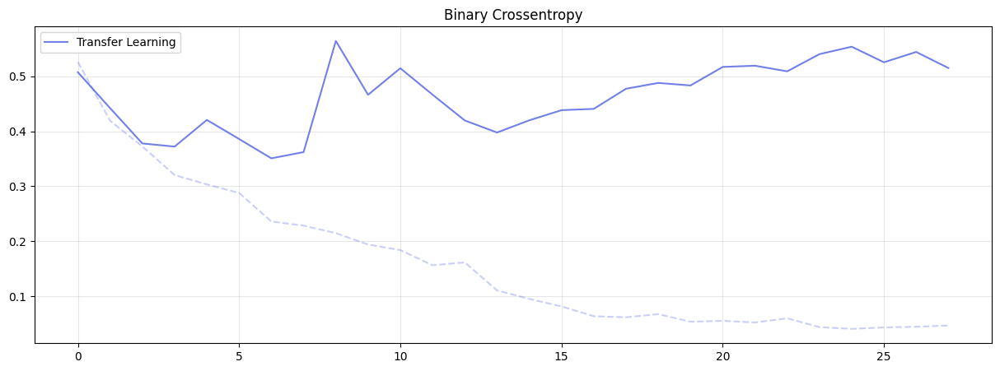

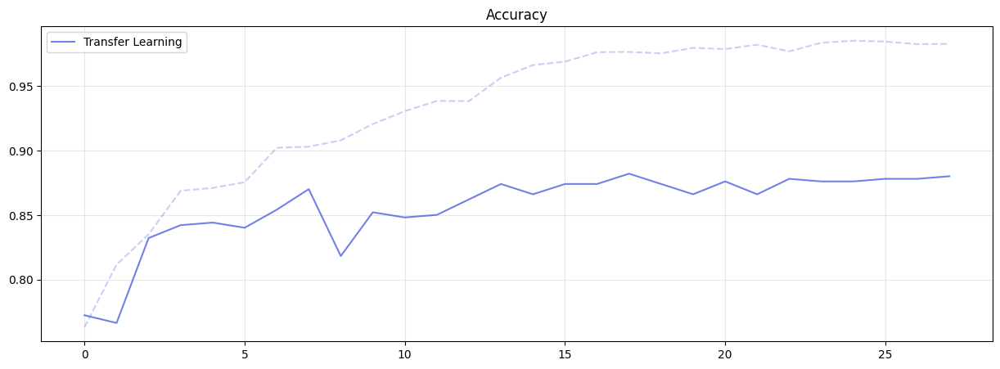

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(EfficientNetV2S_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2S_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(EfficientNetV2S_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2S_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
EfficientNetV2S_model.get_layer('efficientnetv2-s').trainable = True

for i, layer in enumerate(EfficientNetV2S_model.get_layer("efficientnetv2-s").layers):
  print(i, layer.name, layer.trainable)

0 input_16 True
1 rescaling True
2 stem_conv True
3 stem_bn True
4 stem_activation True
5 block1a_project_conv True
6 block1a_project_bn True
7 block1a_project_activation True
8 block1a_add True
9 block1b_project_conv True
10 block1b_project_bn True
11 block1b_project_activation True
12 block1b_drop True
13 block1b_add True
14 block2a_expand_conv True
15 block2a_expand_bn True
16 block2a_expand_activation True
17 block2a_project_conv True
18 block2a_project_bn True
19 block2b_expand_conv True
20 block2b_expand_bn True
21 block2b_expand_activation True
22 block2b_project_conv True
23 block2b_project_bn True
24 block2b_drop True
25 block2b_add True
26 block2c_expand_conv True
27 block2c_expand_bn True
28 block2c_expand_activation True
29 block2c_project_conv True
30 block2c_project_bn True
31 block2c_drop True
32 block2c_add True
33 block2d_expand_conv True
34 block2d_expand_bn True
35 block2d_expand_activation True
36 block2d_project_conv True
37 block2d_project_bn True
38 block2d_drop 

In [ ]:
# Freeze first N layers
#N = 480 overfit with 88% accuracy
N=495
for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2S_model.summary()

0 input_16 False
1 rescaling False
2 stem_conv False
3 stem_bn False
4 stem_activation False
5 block1a_project_conv False
6 block1a_project_bn False
7 block1a_project_activation False
8 block1a_add False
9 block1b_project_conv False
10 block1b_project_bn False
11 block1b_project_activation False
12 block1b_drop False
13 block1b_add False
14 block2a_expand_conv False
15 block2a_expand_bn False
16 block2a_expand_activation False
17 block2a_project_conv False
18 block2a_project_bn False
19 block2b_expand_conv False
20 block2b_expand_bn False
21 block2b_expand_activation False
22 block2b_project_conv False
23 block2b_project_bn False
24 block2b_drop False
25 block2b_add False
26 block2c_expand_conv False
27 block2c_expand_bn False
28 block2c_expand_activation False
29 block2c_project_conv False
30 block2c_project_bn False
31 block2c_drop False
32 block2c_add False
33 block2d_expand_conv False
34 block2d_expand_bn False
35 block2d_expand_activation False
36 block2d_project_conv False
37 blo

In [ ]:
EfficientNetV2S_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.AdamW(1e-4,weight_decay=1e-5), metrics=['accuracy'])

callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=10, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]


# Train the model
EfficientNetV2S_history = EfficientNetV2S_model.fit(
    x = tfk.applications.efficientnet_v2.preprocess_input(augmentedX),
    y = augmentedy,
    batch_size = 32,
    epochs = 20,
    validation_data = (tfk.applications.efficientnet_v2.preprocess_input(X_val*255), y_val),
    callbacks = callbacks
).history

Epoch 1/20
123/123 [==============================] - 23s 68ms/step - loss: 0.1964 - accuracy: 0.9182 - val_loss: 78.3602 - val_accuracy: 0.4805 - lr: 1.0000e-04
Epoch 2/20
123/123 [==============================] - 5s 39ms/step - loss: 0.1592 - accuracy: 0.9397 - val_loss: 109.4758 - val_accuracy: 0.4333 - lr: 1.0000e-04
Epoch 3/20
123/123 [==============================] - 5s 40ms/step - loss: 0.1389 - accuracy: 0.9504 - val_loss: 117.0526 - val_accuracy: 0.4415 - lr: 1.0000e-04
Epoch 4/20
123/123 [==============================] - 5s 40ms/step - loss: 0.2169 - accuracy: 0.9128 - val_loss: 124.3410 - val_accuracy: 0.4517 - lr: 1.0000e-04
Epoch 5/20
 11/123 [=>............................] - ETA: 3s - loss: 0.1587 - accuracy: 0.9375

KeyboardInterrupt: ignored

In [ ]:
EfficientNetV2S_model.get_layer('efficientnetv2-s').trainable = True

N = 450 #included
M = 480 #not included
for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers[M:]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2S_model.get_layer('efficientnetv2-s').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2S_model.summary()

0 input_1 False
1 rescaling False
2 stem_conv False
3 stem_bn False
4 stem_activation False
5 block1a_project_conv False
6 block1a_project_bn False
7 block1a_project_activation False
8 block1a_add False
9 block1b_project_conv False
10 block1b_project_bn False
11 block1b_project_activation False
12 block1b_drop False
13 block1b_add False
14 block2a_expand_conv False
15 block2a_expand_bn False
16 block2a_expand_activation False
17 block2a_project_conv False
18 block2a_project_bn False
19 block2b_expand_conv False
20 block2b_expand_bn False
21 block2b_expand_activation False
22 block2b_project_conv False
23 block2b_project_bn False
24 block2b_drop False
25 block2b_add False
26 block2c_expand_conv False
27 block2c_expand_bn False
28 block2c_expand_activation False
29 block2c_project_conv False
30 block2c_project_bn False
31 block2c_drop False
32 block2c_add False
33 block2d_expand_conv False
34 block2d_expand_bn False
35 block2d_expand_activation False
36 block2d_project_conv False
37 bloc

In [ ]:
EfficientNetV2S_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.AdamW(1e-5,1e-5), metrics=['accuracy'])

callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=5, restore_best_weights=True, mode='max'),
    #tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]


# Train the model
EfficientNetV2S_history = EfficientNetV2S_model.fit(
    x = tfk.applications.efficientnet_v2.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 32,
    epochs = 10,
    validation_data = (tfk.applications.efficientnet_v2.preprocess_input(X_val*255), y_val),
    callbacks = callbacks
).history

Epoch 1/10
141/141 [==============================] - 25s 54ms/step - loss: 0.0514 - accuracy: 0.9836 - val_loss: 0.5137 - val_accuracy: 0.8563
Epoch 2/10
141/141 [==============================] - 4s 28ms/step - loss: 0.0426 - accuracy: 0.9871 - val_loss: 0.5318 - val_accuracy: 0.8623
Epoch 3/10
141/141 [==============================] - 4s 28ms/step - loss: 0.0337 - accuracy: 0.9893 - val_loss: 0.5292 - val_accuracy: 0.8623
Epoch 4/10
141/141 [==============================] - 4s 29ms/step - loss: 0.0336 - accuracy: 0.9898 - val_loss: 0.5343 - val_accuracy: 0.8643
Epoch 5/10
141/141 [==============================] - 4s 28ms/step - loss: 0.0317 - accuracy: 0.9909 - val_loss: 0.5224 - val_accuracy: 0.8643
Epoch 6/10
141/141 [==============================] - 4s 29ms/step - loss: 0.0266 - accuracy: 0.9942 - val_loss: 0.5219 - val_accuracy: 0.8762
Epoch 7/10
141/141 [==============================] - 4s 27ms/step - loss: 0.0259 - accuracy: 0.9949 - val_loss: 0.5347 - val_accuracy: 0.872

41480120/41480120 [==============================] - 2s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.841971 to fit



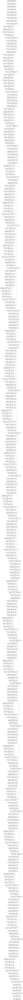

In [ ]:


model = tfk.applications.EfficientNetV2B2(
    include_top = True,
    weights = 'imagenet',
    )
tfk.utils.plot_model(model, show_shapes=True)

# EfficientNetV2B2

In [ ]:
def build_EfficientNetV2B2_model(input_shape = input_shape):


  model = tfk.applications.EfficientNetV2B2(
    include_top = False,
    input_shape = (96, 96, 3),
    pooling = 'avg'
  )
  tfk.utils.plot_model(model, show_shapes=True)

  #set all layers trainable
  model.trainable=False


  inputs = tfk.Input(input_shape)
  #C = tfk.layers.Resizing(260, 260)(inputs)
  x = model(inputs)
  dropout_top = tfkl.Dropout(0.4)(x)
  outputs = tfkl.Dense(units=2,activation='softmax')(dropout_top)

  model = tfk.Model(inputs=inputs, outputs=outputs, name='EfficientNetV2B2_model')

  #N=480
  #for i, layer in enumerate(model.get_layer('efficientnetv2-b2').layers[:N]):
    #layer.trainable=False


  return model


EfficientNetV2B2_model = build_EfficientNetV2B2_model()

for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers):
  print(i, layer.name, layer.trainable)
EfficientNetV2B2_model.summary()


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.84678 to fit

0 input_5 False
1 rescaling_2 False
2 normalization_2 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block1b_project_conv False
10 block1b_project_bn False
11 block1b_project_activation False
12 block1b_drop False
13 block1b_add False
14 block2a_expand_conv False
15 block2a_expand_bn False
16 block2a_expand_activation False
17 block2a_project_conv False
18 block2a_project_bn False
19 block2b_expand_conv False
20 block2b_expand_bn False
21 block2b_expand_activation False
22 block2b_project_conv False
23 block2b_project_bn False
24 block2b_drop False
25 block2b_add False
26 block2c_expand_conv False
27 block2c_expand_bn False
28 block2c_expand_activation False
29 block2c_project_conv False
30 block2c_project_bn False
31 block2c_drop False
32 block2c_add False
33 block3a_expand_conv False
34 block3a_exp

In [ ]:

# Compile the model
EfficientNetV2B2_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(0.001),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=30, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=20, factor=0.1, min_lr=1e-5)
]

# Train the model
EfficientNetV2B2_history = EfficientNetV2B2_model.fit(
    x = augmentedX,
    y = augmentedy,
    batch_size = 32,
    epochs = 80,
    validation_data = (X_val, y_val),
    callbacks = callbacks
).history



Epoch 1/80
162/162 [==============================] - 15s 40ms/step - loss: 0.5127 - accuracy: 0.7580 - val_loss: 1.4317 - val_accuracy: 0.2671 - lr: 0.0010
Epoch 2/80
162/162 [==============================] - 4s 23ms/step - loss: 0.4429 - accuracy: 0.8000 - val_loss: 1.4768 - val_accuracy: 0.2128 - lr: 0.0010
Epoch 3/80
162/162 [==============================] - 4s 23ms/step - loss: 0.4195 - accuracy: 0.8090 - val_loss: 1.5118 - val_accuracy: 0.2071 - lr: 0.0010
Epoch 4/80
 28/162 [====>.........................] - ETA: 2s - loss: 0.3856 - accuracy: 0.8348

KeyboardInterrupt: ignored

In [ ]:
EfficientNetV2B2_model.save('fl_resize260_withAugmentation_EfficientNetV2B2')
#model = tfk.models.load_model('tf_EfficientNetV2B2')


In [ ]:
EfficientNetV2B2_model.get_layer('efficientnetv2-b2').trainable = True

for i, layer in enumerate(EfficientNetV2B2_model.get_layer("efficientnetv2-b2").layers):
  print(i, layer.name, layer.trainable)

In [ ]:
EfficientNetV2B2_model.get_layer('efficientnetv2-b2').trainable = True

# Freeze first N layers, if N=125 add_11 = False
N = 331
for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2B2_model.summary()

In [ ]:
EfficientNetV2B2_model.get_layer('efficientnetv2-b2').trainable = True

N = 331
M = 346
for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers[M:]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B2_model.get_layer('efficientnetv2-b2').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2B2_model.summary()

In [ ]:

# Compile the model
EfficientNetV2B2_model.compile(loss=tfk.losses.BinaryCrossentropy(), optimizer=tfk.optimizers.AdamW(1e-4),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=15, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=5, factor=0.1, min_lr=1e-5)
]

# Train the model
ft_EfficientNetV2B2_history = EfficientNetV2B2_model.fit(
    x = tfk.applications.efficientnet_v2.preprocess_input(X_train*255),
    y = y_train,
    batch_size = 32,
    epochs = 25,
    validation_data = (tfk.applications.efficientnet_v2.preprocess_input(X_val*255), y_val),
    callbacks = callbacks
).history



Epoch 1/25
141/141 [==============================] - 18s 56ms/step - loss: 0.4187 - accuracy: 0.8077 - val_loss: 0.3896 - val_accuracy: 0.8363 - lr: 1.0000e-04
Epoch 2/25
141/141 [==============================] - 3s 23ms/step - loss: 0.3998 - accuracy: 0.8159 - val_loss: 0.3821 - val_accuracy: 0.8303 - lr: 1.0000e-04
Epoch 3/25
141/141 [==============================] - 3s 24ms/step - loss: 0.3765 - accuracy: 0.8334 - val_loss: 0.3594 - val_accuracy: 0.8423 - lr: 1.0000e-04
Epoch 4/25
141/141 [==============================] - 3s 23ms/step - loss: 0.3547 - accuracy: 0.8414 - val_loss: 0.3562 - val_accuracy: 0.8383 - lr: 1.0000e-04
Epoch 5/25
141/141 [==============================] - 3s 24ms/step - loss: 0.3399 - accuracy: 0.8541 - val_loss: 0.3437 - val_accuracy: 0.8283 - lr: 1.0000e-04
Epoch 6/25
141/141 [==============================] - 3s 24ms/step - loss: 0.3265 - accuracy: 0.8579 - val_loss: 0.3349 - val_accuracy: 0.8463 - lr: 1.0000e-04
Epoch 7/25
141/141 [===================

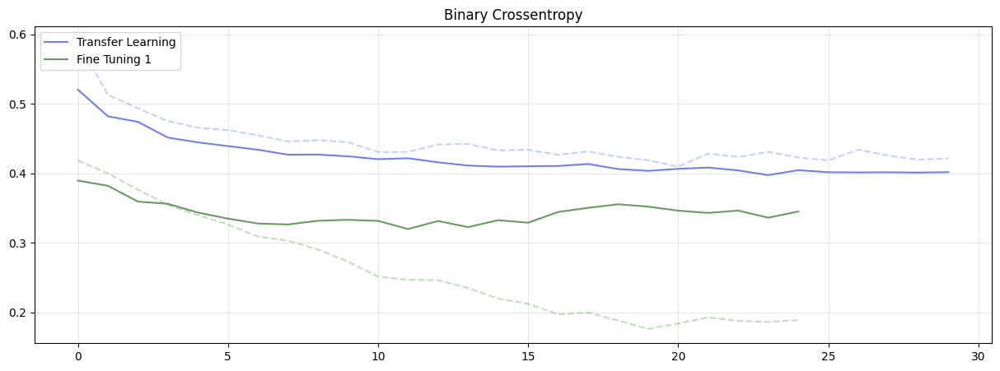

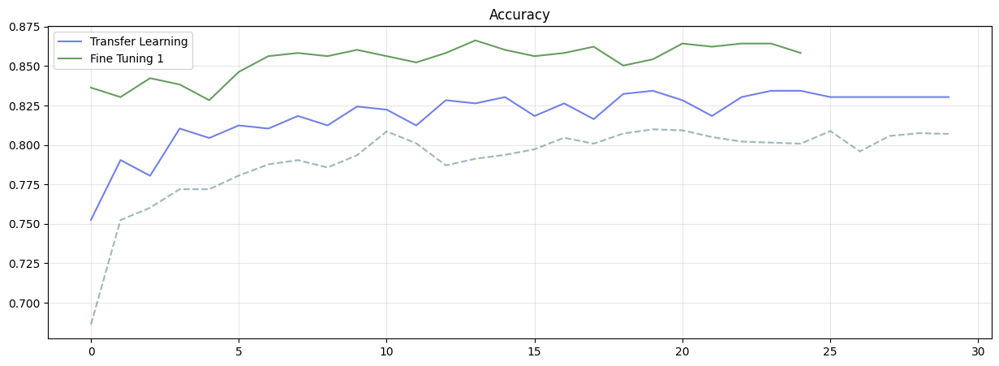

In [ ]:
# Plot the re-trained, the transfer learning and the fine-tuned MobileNetV2 training histories
plt.figure(figsize=(15,5))
plt.plot(EfficientNetV2B2_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2B2_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(ft_EfficientNetV2B2_history['loss'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft_EfficientNetV2B2_history['val_loss'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))

plt.plot(EfficientNetV2B2_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2B2_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(EfficientNetV2B2_history['accuracy'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft_EfficientNetV2B2_history['val_accuracy'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

# EfficientNetV2B0

In [ ]:
data_augmentation = tfk.Sequential(
    [
        tfk.layers.RandomFlip("horizontal"),
        tfk.layers.RandomRotation(0.1),
        tfk.layers.RandomZoom(0.2)
    ]
)

In [ ]:
datagen = ImageDataGenerator(
        rotation_range=40,
        width_shift_range=0.2,
        height_shift_range=0.2,
        rescale=1./255,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
        fill_mode='nearest')

In [ ]:
def build_EfficientNetV2B0_model(input_shape = input_shape):


  model = tfk.applications.EfficientNetV2B0(
    include_top = False,
    weights = 'imagenet',
    input_shape = (96,96,3),
    pooling = 'avg'
  )
  tfk.utils.plot_model(model, show_shapes=True)

  #set all layers trainable
  model.trainable=False


  inputs = tfk.Input(input_shape)
  #C = tfk.layers.Resizing(260, 260)(inputs)
  #x = data_augmentation(inputs)
  x = model(inputs, training=False)
  dropout_top = tfkl.Dropout(0.4)(x)
  outputs = tfkl.Dense(units=2,activation='softmax')(dropout_top)

  model = tfk.Model(inputs=inputs, outputs=outputs, name='EfficientNetV2B0_model')

  return model


EfficientNetV2B0_model = build_EfficientNetV2B0_model()

for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers):
  print(i, layer.name, layer.trainable)
EfficientNetV2B0_model.summary()

0 input_46 False
1 rescaling_6 False
2 normalization_5 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_drop False
20 block2b_add False
21 block3a_expand_conv False
22 block3a_expand_bn False
23 block3a_expand_activation False
24 block3a_project_conv False
25 block3a_project_bn False
26 block3b_expand_conv False
27 block3b_expand_bn False
28 block3b_expand_activation False
29 block3b_project_conv False
30 block3b_project_bn False
31 block3b_drop False
32 block3b_add False
33 block4a_expand_conv False
34 block4a_expand_bn False
35 block4a_expand_activation False
36 block4a_dwconv2

In [ ]:

# Compile the model
EfficientNetV2B0_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.AdamW(0.001,weight_decay=0.1),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=100, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=35, factor=0.1, min_lr=1e-5)
]

# Train the model
EfficientNetV2B0_history = EfficientNetV2B0_model.fit(
    x = augmentedX,
    y = augmentedy,
    batch_size = 32,
    epochs = 200,
    validation_data = (X_val, y_val),
    callbacks = callbacks
).history



Epoch 1/200
144/144 [==============================] - 12s 40ms/step - loss: 0.5184 - accuracy: 0.7439 - val_loss: 1.3103 - val_accuracy: 0.2169 - lr: 0.0010
Epoch 2/200
144/144 [==============================] - 3s 19ms/step - loss: 0.4309 - accuracy: 0.8058 - val_loss: 1.6463 - val_accuracy: 0.2334 - lr: 0.0010
Epoch 3/200
144/144 [==============================] - 3s 18ms/step - loss: 0.4102 - accuracy: 0.8186 - val_loss: 1.7550 - val_accuracy: 0.2202 - lr: 0.0010
Epoch 4/200
144/144 [==============================] - 3s 18ms/step - loss: 0.3947 - accuracy: 0.8225 - val_loss: 1.7388 - val_accuracy: 0.1906 - lr: 0.0010
Epoch 5/200
144/144 [==============================] - 3s 18ms/step - loss: 0.3845 - accuracy: 0.8332 - val_loss: 1.8068 - val_accuracy: 0.1931 - lr: 0.0010
Epoch 6/200
144/144 [==============================] - 3s 18ms/step - loss: 0.3880 - accuracy: 0.8269 - val_loss: 1.7687 - val_accuracy: 0.1906 - lr: 0.0010
Epoch 7/200
 57/144 [==========>...................] - ET

KeyboardInterrupt: ignored

In [ ]:
EfficientNetV2B0_model.save('efficientNETV2B0_AUG')

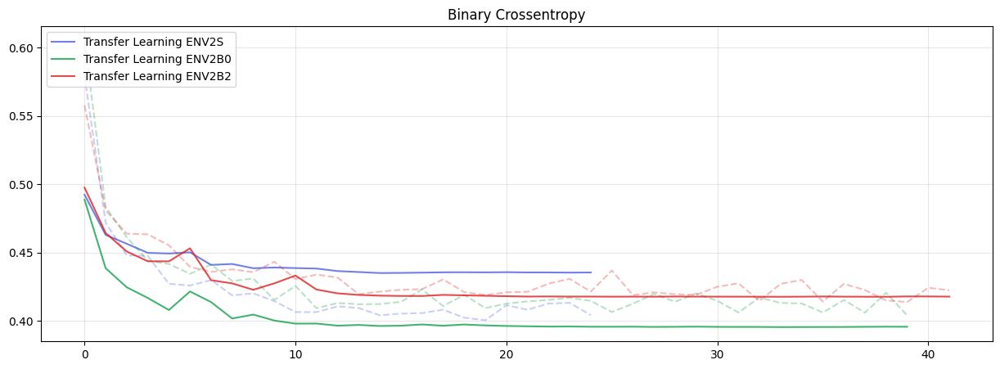

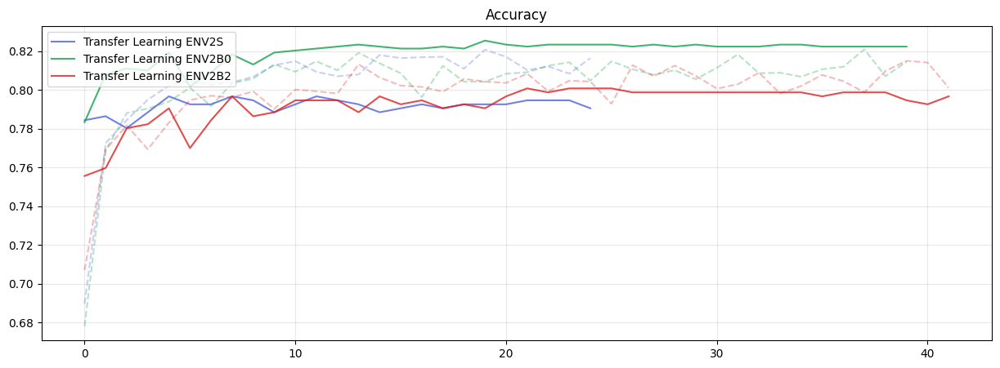

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(EfficientNetV2S_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2S_history['val_loss'], label='Transfer Learning ENV2S', alpha=.8, color='#4D61E2')
plt.plot(EfficientNetV2B0_history['loss'], alpha=.3, color='#12a14b', linestyle='--')
plt.plot(EfficientNetV2B0_history['val_loss'], label='Transfer Learning ENV2B0', alpha=.8, color='#12a14b')
plt.plot(EfficientNetV2B2_history['loss'], alpha=.3, color='#de1f21', linestyle='--')
plt.plot(EfficientNetV2B2_history['val_loss'], label='Transfer Learning ENV2B2', alpha=.8, color='#de1f21')

plt.legend(loc='upper left')
plt.title('Binary Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))
plt.plot(EfficientNetV2S_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(EfficientNetV2S_history['val_accuracy'], label='Transfer Learning ENV2S', alpha=.8, color='#4D61E2')
plt.plot(EfficientNetV2B0_history['accuracy'], alpha=.3, color='#12a14b', linestyle='--')
plt.plot(EfficientNetV2B0_history['val_accuracy'], label='Transfer Learning ENV2B0', alpha=.8, color='#12a14b')
plt.plot(EfficientNetV2B2_history['accuracy'], alpha=.3, color='#de1f21', linestyle='--')
plt.plot(EfficientNetV2B2_history['val_accuracy'], label='Transfer Learning ENV2B2', alpha=.8, color='#de1f21')

plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()

In [ ]:
EfficientNetV2B0_model.get_layer('efficientnetv2-b0').trainable = True

for i, layer in enumerate(EfficientNetV2B0_model.get_layer("efficientnetv2-b0").layers):
  print(i, layer.name, layer.trainable)

In [ ]:
EfficientNetV2B0_model.get_layer('efficientnetv2-b0').trainable = True

# Freeze first N layers, if N=125 add_11 = False
N = 237
#N = 252
#N=222
#N=207
for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2B0_model.summary()

0 input_21 False
1 rescaling_6 False
2 normalization_6 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_drop False
20 block2b_add False
21 block3a_expand_conv False
22 block3a_expand_bn False
23 block3a_expand_activation False
24 block3a_project_conv False
25 block3a_project_bn False
26 block3b_expand_conv False
27 block3b_expand_bn False
28 block3b_expand_activation False
29 block3b_project_conv False
30 block3b_project_bn False
31 block3b_drop False
32 block3b_add False
33 block4a_expand_conv False
34 block4a_expand_bn False
35 block4a_expand_activation False
36 block4a_dwconv2

In [ ]:
EfficientNetV2B0_model.get_layer('efficientnetv2-b0').trainable = True

N = 207
M = 222
for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers[:N]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers[M:]):
  layer.trainable=False
for i, layer in enumerate(EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers):
   print(i, layer.name, layer.trainable)
EfficientNetV2B0_model.summary()

0 input_17 False
1 rescaling_4 False
2 normalization_4 False
3 stem_conv False
4 stem_bn False
5 stem_activation False
6 block1a_project_conv False
7 block1a_project_bn False
8 block1a_project_activation False
9 block2a_expand_conv False
10 block2a_expand_bn False
11 block2a_expand_activation False
12 block2a_project_conv False
13 block2a_project_bn False
14 block2b_expand_conv False
15 block2b_expand_bn False
16 block2b_expand_activation False
17 block2b_project_conv False
18 block2b_project_bn False
19 block2b_drop False
20 block2b_add False
21 block3a_expand_conv False
22 block3a_expand_bn False
23 block3a_expand_activation False
24 block3a_project_conv False
25 block3a_project_bn False
26 block3b_expand_conv False
27 block3b_expand_bn False
28 block3b_expand_activation False
29 block3b_project_conv False
30 block3b_project_bn False
31 block3b_drop False
32 block3b_add False
33 block4a_expand_conv False
34 block4a_expand_bn False
35 block4a_expand_activation False
36 block4a_dwconv2

In [ ]:
EfficientNetV2B0_model.get_layer('efficientnetv2-b0').trainable = True
# 14 24 34 124
for i, layer in enumerate(EfficientNetV2B0_model.get_layer("efficientnetv2-b0").layers):
  print(i, layer.name, layer.trainable)

  EfficientNetV2B0_model.get_layer('efficientnetv2-b0').layers[2].trainable = False



In [ ]:

# Compile the model
EfficientNetV2B0_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.SGD(1e-3,momentum=0.9),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=50, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=10, factor=0.1, min_lr=1e-5)
]

# Train the model
EfficientNetV2B0_history = EfficientNetV2B0_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 32,
    epochs = 50,
    validation_data = (X_val, y_val),
    callbacks = callbacks
).history



Epoch 1/50
122/122 [==============================] - 22s 113ms/step - loss: 0.3839 - accuracy: 0.8210 - val_loss: 0.3746 - val_accuracy: 0.8357 - lr: 0.0010
Epoch 2/50
122/122 [==============================] - 12s 97ms/step - loss: 0.3486 - accuracy: 0.8520 - val_loss: 0.3560 - val_accuracy: 0.8450 - lr: 0.0010
Epoch 3/50
122/122 [==============================] - 12s 98ms/step - loss: 0.3379 - accuracy: 0.8562 - val_loss: 0.3533 - val_accuracy: 0.8480 - lr: 0.0010
Epoch 4/50
122/122 [==============================] - 12s 98ms/step - loss: 0.3227 - accuracy: 0.8585 - val_loss: 0.3537 - val_accuracy: 0.8542 - lr: 0.0010
Epoch 5/50
122/122 [==============================] - 12s 97ms/step - loss: 0.3177 - accuracy: 0.8605 - val_loss: 0.3595 - val_accuracy: 0.8460 - lr: 0.0010
Epoch 6/50
122/122 [==============================] - 12s 96ms/step - loss: 0.2982 - accuracy: 0.8739 - val_loss: 0.3559 - val_accuracy: 0.8429 - lr: 0.0010
Epoch 7/50
122/122 [==============================] - 12s

KeyboardInterrupt: ignored

In [ ]:
EfficientNetV2B2_model.save('ft_withAugmentation_EfficientNetV2B0')
#model = tfk.models.load_model('tf_EfficientNetV2B2')


201633160/201633160 [==============================] - 12s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.998051 to fit



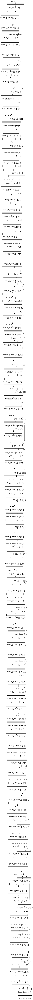

In [ ]:
gg = tfk.applications.ConvNeXtSmall(
    include_top = False,
    weights = 'imagenet',
    input_shape = (96,96,3),
    pooling = 'avg'
  )

tfk.utils.plot_model(gg, show_shapes=True)

201633160/201633160 [==============================] - 11s 0us/step
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.998051 to fit



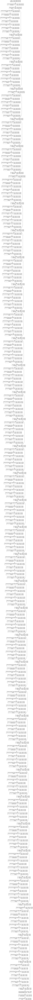

In [ ]:
a = tfk.applications.ConvNeXtSmall(
    include_top = True,
    weights = 'imagenet',
  )
tfk.utils.plot_model(a, show_shapes=True)

# ConvNeXtSmall

In [ ]:
def build_ConvNeXtS_model(input_shape = input_shape):


  model = tfk.applications.ConvNeXtSmall(
    include_top = False,
    weights = 'imagenet',
    input_shape = (96,96,3),
    pooling = 'avg',
  )
  tfk.utils.plot_model(model, show_shapes=True)

  preprocessing = tf.keras.Sequential([
        #tfkl.RandomContrast(0.75),
        tfkl.RandomZoom(height_factor=(-0.1),width_factor=(-0.2, -0.2)),
        tfkl.RandomFlip(mode="horizontal"),
        tfkl.RandomRotation(0.3),
    ], name='preprocessing')


  #set all layers trainable
  model.trainable=False


  inputs = tfk.Input(input_shape)
  #preprocessing = preprocessing(inputs)
  #C = tfk.layers.Resizing(130, 130)(inputs)
  #x = data_augmentation(inputs)
  x = model(inputs, training=False)
  dropout_top = tfkl.Dropout(0.4)(x)
  outputs = tfkl.Dense(units=2,activation='softmax')(dropout_top)

  model = tfk.Model(inputs=inputs, outputs=outputs, name='ConvNeXtS_model')

  return model


COnvNeXtS_model = build_ConvNeXtS_model()

#for i, layer in enumerate(COnvNeXtS_model.get_layer('efficientnetv2-b0').layers):
  #print(i, layer.name, layer.trainable)
COnvNeXtS_model.summary()

198551472/198551472 [==============================] - 8s 0us/step
Model: "ConvNeXtS_model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 96, 96, 3)]       0         
                                                                 
 convnext_small (Functional  (None, 768)               49454688  
 )                                                               
                                                                 
 dropout (Dropout)           (None, 768)               0         
                                                                 
 dense (Dense)               (None, 2)                 1538      
                                                                 
Total params: 49456226 (188.66 MB)
Trainable params: 1538 (6.01 KB)
Non-trainable params: 49454688 (188.65 MB)
_________________________________________________________________


In [ ]:

# Compile the model
COnvNeXtS_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.Adam(),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=10, restore_best_weights=True, mode='max'),
    tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=10, factor=0.1, min_lr=1e-5)
]

# Train the model
COnvNeXtS_history = COnvNeXtS_model.fit(
    x = X_train,
    y = y_train,
    batch_size = 64,
    epochs = 50,
    validation_data = (X_val, y_val),
    callbacks = callbacks
).history


Epoch 1/50
58/58 [==============================] - 53s 450ms/step - loss: 0.8278 - accuracy: 0.5882 - val_loss: 0.5524 - val_accuracy: 0.7247 - lr: 0.0010
Epoch 2/50
58/58 [==============================] - 12s 207ms/step - loss: 0.6703 - accuracy: 0.6636 - val_loss: 0.5363 - val_accuracy: 0.7157 - lr: 0.0010
Epoch 3/50
58/58 [==============================] - 12s 211ms/step - loss: 0.5913 - accuracy: 0.7019 - val_loss: 0.5012 - val_accuracy: 0.7675 - lr: 0.0010
Epoch 4/50
58/58 [==============================] - 12s 212ms/step - loss: 0.5740 - accuracy: 0.7107 - val_loss: 0.4787 - val_accuracy: 0.7814 - lr: 0.0010
Epoch 5/50
58/58 [==============================] - 12s 214ms/step - loss: 0.5419 - accuracy: 0.7332 - val_loss: 0.4585 - val_accuracy: 0.7921 - lr: 0.0010
Epoch 6/50
58/58 [==============================] - 12s 213ms/step - loss: 0.5293 - accuracy: 0.7386 - val_loss: 0.4665 - val_accuracy: 0.7765 - lr: 0.0010
Epoch 7/50
58/58 [==============================] - 13s 218ms/st

In [ ]:
COnvNeXtS_model.get_layer('convnext_small').trainable = True

for i, layer in enumerate(COnvNeXtS_model.get_layer("convnext_small").layers):
  print(i, layer.name, layer.trainable)

0 input_14 True
1 convnext_small_prestem_normalization True
2 convnext_small_stem True
3 convnext_small_stage_0_block_0_depthwise_conv True
4 convnext_small_stage_0_block_0_layernorm True
5 convnext_small_stage_0_block_0_pointwise_conv_1 True
6 convnext_small_stage_0_block_0_gelu True
7 convnext_small_stage_0_block_0_pointwise_conv_2 True
8 convnext_small_stage_0_block_0_layer_scale True
9 convnext_small_stage_0_block_0_identity True
10 tf.__operators__.add_243 True
11 convnext_small_stage_0_block_1_depthwise_conv True
12 convnext_small_stage_0_block_1_layernorm True
13 convnext_small_stage_0_block_1_pointwise_conv_1 True
14 convnext_small_stage_0_block_1_gelu True
15 convnext_small_stage_0_block_1_pointwise_conv_2 True
16 convnext_small_stage_0_block_1_layer_scale True
17 convnext_small_stage_0_block_1_identity True
18 tf.__operators__.add_244 True
19 convnext_small_stage_0_block_2_depthwise_conv True
20 convnext_small_stage_0_block_2_layernorm True
21 convnext_small_stage_0_block_2_p

In [ ]:
COnvNeXtS_model.get_layer('convnext_small').trainable = True

N=286
for i, layer in enumerate(COnvNeXtS_model.get_layer('convnext_small').layers[:N]):
    layer.trainable=False
COnvNeXtS_model.get_layer('convnext_small').layers[295].trainable = False
COnvNeXtS_model.get_layer('convnext_small').layers[287].trainable = False


for i, layer in enumerate(COnvNeXtS_model.get_layer('convnext_small').layers):
   print(i, layer.name, layer.trainable)
COnvNeXtS_model.summary()

0 input_30 False
1 convnext_small_prestem_normalization False
2 convnext_small_stem False
3 convnext_small_stage_0_block_0_depthwise_conv False
4 convnext_small_stage_0_block_0_layernorm False
5 convnext_small_stage_0_block_0_pointwise_conv_1 False
6 convnext_small_stage_0_block_0_gelu False
7 convnext_small_stage_0_block_0_pointwise_conv_2 False
8 convnext_small_stage_0_block_0_layer_scale False
9 convnext_small_stage_0_block_0_identity False
10 tf.__operators__.add_504 False
11 convnext_small_stage_0_block_1_depthwise_conv False
12 convnext_small_stage_0_block_1_layernorm False
13 convnext_small_stage_0_block_1_pointwise_conv_1 False
14 convnext_small_stage_0_block_1_gelu False
15 convnext_small_stage_0_block_1_pointwise_conv_2 False
16 convnext_small_stage_0_block_1_layer_scale False
17 convnext_small_stage_0_block_1_identity False
18 tf.__operators__.add_505 False
19 convnext_small_stage_0_block_2_depthwise_conv False
20 convnext_small_stage_0_block_2_layernorm False
21 convnext_sm

In [ ]:
# Compile the model
COnvNeXtS_model.compile(loss=tfk.losses.CategoricalCrossentropy(), optimizer=tfk.optimizers.SGD(1e-2,momentum=0.9),metrics=['accuracy'])
#EfficientNetV2B2_model.summary()


callbacks = [
    tfk.callbacks.EarlyStopping(monitor='val_accuracy',patience=25, restore_best_weights=True, mode='max'),
    #tfk.callbacks.ReduceLROnPlateau(monitor="val_accuracy", patience=25, factor=0.1, min_lr=1e-5)
]

# Train the model
ft1_COnvNeXtS_history = COnvNeXtS_model.fit(
    x = augmentedX,
    y = augmentedy,
    batch_size = 32,
    epochs = 30,
    validation_data = (X_val, y_val),
    callbacks = callbacks
).history



Epoch 1/30
174/174 [==============================] - 45s 169ms/step - loss: 1.0800 - accuracy: 0.7092 - val_loss: 1.4172 - val_accuracy: 0.6838
Epoch 2/30
174/174 [==============================] - 19s 108ms/step - loss: 0.8524 - accuracy: 0.7714 - val_loss: 0.6559 - val_accuracy: 0.7926
Epoch 3/30
174/174 [==============================] - 18s 106ms/step - loss: 0.8741 - accuracy: 0.7951 - val_loss: 1.6529 - val_accuracy: 0.7474
Epoch 4/30
174/174 [==============================] - 18s 104ms/step - loss: 0.8220 - accuracy: 0.8124 - val_loss: 1.0229 - val_accuracy: 0.7762
Epoch 5/30
174/174 [==============================] - 18s 104ms/step - loss: 0.7664 - accuracy: 0.8207 - val_loss: 1.0070 - val_accuracy: 0.7813
Epoch 6/30
174/174 [==============================] - 18s 106ms/step - loss: 0.6562 - accuracy: 0.8384 - val_loss: 0.7701 - val_accuracy: 0.8337
Epoch 7/30
174/174 [==============================] - 18s 105ms/step - loss: 0.5483 - accuracy: 0.8539 - val_loss: 0.8912 - val_ac

KeyboardInterrupt: ignored

In [ ]:
COnvNeXtS_model.get_layer('convnext_small').trainable = True

N=286
for i, layer in enumerate(COnvNeXtS_model.get_layer('convnext_small').layers[:N]):
    layer.trainable=False
for i, layer in enumerate(COnvNeXtS_model.get_layer('convnext_small').layers[M:]):
  layer.trainable=False
COnvNeXtS_model.get_layer('convnext_small').layers[295].trainable = False
COnvNeXtS_model.get_layer('convnext_small').layers[287].trainable = False


for i, layer in enumerate(COnvNeXtS_model.get_layer('convnext_small').layers):
   print(i, layer.name, layer.trainable)
COnvNeXtS_model.summary()

In [ ]:
# Plot the re-trained, the transfer learning and the fine-tuned MobileNetV2 training histories
plt.figure(figsize=(15,5))
plt.plot(COnvNeXtS_history['loss'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(COnvNeXtS_history['val_loss'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(ft1_COnvNeXtS_history['loss'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft1_COnvNeXtS_history['val_loss'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Categorical Crossentropy')
plt.grid(alpha=.3)

plt.figure(figsize=(15,5))

plt.plot(COnvNeXtS_history['accuracy'], alpha=.3, color='#4D61E2', linestyle='--')
plt.plot(COnvNeXtS_history['val_accuracy'], label='Transfer Learning', alpha=.8, color='#4D61E2')
plt.plot(ft1_COnvNeXtS_history['accuracy'], alpha=.3, color='#408537', linestyle='--')
plt.plot(ft1_COnvNeXtS_history['val_accuracy'], label='Fine Tuning 1', alpha=.8, color='#408537')
plt.legend(loc='upper left')
plt.title('Accuracy')
plt.grid(alpha=.3)

plt.show()